# Машинное обучение, ВМК МГУ

# Практическое задание 3. Обучение без учителя.

## Общая информация
Дата выдачи: 13.04.2023

Мягкий дедлайн: 27.04.2023 03:30 MSK **(за каждый день просрочки снимается 1 балл)**

Жёсткий дедлайн: 04.05.2023 03:30 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — **10 баллов + 4.4 бонусов**.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-03-Username.ipynb

Username — ваша фамилия на латинице

<p style="color:#de3815;font-size:25px;">
Напоминание об оформлении и выполнении ноутбука
</p>

* Все строчки должны быть выполнены. Нужно, чтобы output команды можно было увидеть, не запуская ячейки (кроме редких случаев, когда необходимо намеренно скрыть ненужный output, про такие случаи желательно писать пояснения в тексте). **В противном случае -1 балл**
* При оформлении ДЗ нужно пользоваться данным файлом в качестве шаблона. Не нужно удалять и видоизменять написанный код и текст, если явно не указана такая возможность. **В противном случае -1 балл**
* В anytask обязательно нужно прикреплять отдельно файл с расширением ipynb (не в архиве, а именно отдельно). Если необходимо отправить еще какие-то файлы, то вынесите их в отдельный архив (если файлов много) и пришлите. **В противном случае -0.5 балла**
---
* Пишите, пожалуйста, выводы и ответы на вопросы в текстовых ячейках/при помощи print в коде. При их отсутствии мы не можем понять, сделали ли вы задание и понимаете, что происходит, и **поэтому будем снижать баллы**
* Если алгоритм не сказано реализовывать явно, его всегда можно импортировать из библиотеки.
---
* Про графики. _Штрафы будут применяться к каждому результату команды отображения графика (plt.show() и др. аналогичные). Исключением являются графики, генерируемые функциями каких-либо сторонних библиотек, если их нельзя кастомизировать_

    * должно быть название (plt.title) графика; **В противном случае &ndash; -0.05 балла**
    * на графиках должны быть подписаны оси (plt.xlabel, plt.ylabel); **В противном случае &ndash; -0.025 балла за каждую ось**
    * должны быть подписаны единицы измерения (если это возможно); **В противном случае &ndash; -0.025 балла за каждую ось**
    * все названия должны быть понятны любому человеку, знакомому с терминологией, без заглядывания в код; **В противном случае &ndash; -0.05 балла**
    * подписи тиков на осях не должны сливаться как на одной оси, так и между ними; **В противном случае &ndash; -0.025 балла за каждую ось**
    * если изображено несколько сущностей на одном холсте (например несколько функций), то необходима поясняющая легенда (plt.legend); **В противном случае &ndash; -0.05 балла**
    * все линии на графиках должны быть чётко видны (нет похожих цветов или цветов, сливающихся с фоном); **В противном случае &ndash; -0.05 балла**
    * если отображена величина, имеющая очевидный диапазон значений (например, проценты могут быть от 0 до 100), то желательно масштабировать ось на весь диапазон значений (исключением является случай, когда вам необходимо показать малое отличие, которое незаметно в таких масштабах);
    * графики должны быть не супер-микро и не супер-макро по размерам, так, чтобы можно было увидеть все, что нужно.
    * при необходимости улучшения наглядности графиков, можно пользоваться логарифмической шкалой по осям x/y.
    

### А также..

* Для удобства поиска вопросов, на которые от вас просят ответа, мы пометили их знаком **(?)**
* Знак **(!)** означает, что выполнение замечания необходимо для **возможности получения полного балла**
* Даем до +0.3 баллов за выдающиеся успехи по субъективному мнению проверяющих. Этот **бонус** не апеллируется

## О задании

В этом задании мы посмотрим на несколько алгоритмов кластеризации и применим их к географическим и текстовым данным. Также мы подробно остановимся на тематическом моделировании текстов, задаче обучения представлений и в каком-то смысле поработаем с semi-supervised learning.



**Замечание:**
* seed менять нежелательно

In [1]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)

## Часть 1. Кластеризация автобусных остановок

В этом задании мы сравним разные алгоритмы кластеризации для данных об автобусных остановках Москвы.

**Задание 1.1 (1 балл).** Реализуйте алгоритм спектральной кластеризации, который упоминался на лекции/семинаре. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Напомним, что для графа с матрицей смежности $W = \{w_{ij}\}_{i, j = 1 \dots \ell}$ лапласиан определяется как:

$$
L = D - W,
$$

где $D = \text{diag}(d_1, ..., d_{\ell}), d_i = \sum_{j=1}^{\ell} w_{ij}$.

In [ ]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''
        self.n_components = n_components if n_components is not None else n_clusters
        self.model = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''
        eigenvectors = self._generate_eigenvectors(X)
        return self.model.fit_predict(eigenvectors[:, 1:])

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''

        # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
        D = np.diag(X.sum(axis=1))
        eigenvalues, eigenvectors = np.linalg.eigh(D - X)
        N = len(eigenvalues)
        idxs = [i for i in range(N)]
        idxs = sorted(idxs, key=lambda x: eigenvalues[x])[:self.n_components]
        eigenvectors = eigenvectors[:, idxs]
        vec_norms = np.apply_along_axis(np.linalg.norm, 0, eigenvectors)
        vec_norms = vec_norms[np.newaxis,:]
        return eigenvectors / vec_norms

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [ ]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


**Замечание**
* Для возможности получения **полного балла** assert должны проходить

Теперь можем приступить к работе с реальными данными. Скачайте файл с данными об остановках общественного транспорта **в формате .xlsx** по [ссылке](https://data.mos.ru/opendata/download/60464/1/201) (так гарантированно не возникнет проблем с парсингом файла) и загрузите таблицу в ноутбук. Если вдруг сайт Правительства Москвы сойдет с ума, то возьмите какую-нибудь версию данных [отсюда](https://data.mos.ru/opendata/7704786030-city-surface-public-transport-stops). Для удобства визуализации мы будем работать только с остановками в ЦАО.

**Замечание**
* (?) Напишите, пожалуйста, откуда в итоге скачивали данные.

Взял данные по ссылке на сайт Правительства Москвы (первая ссылка), всё работало корректно.

In [ ]:
data = pd.read_excel('../input/mmro-spring-3/transport.xlsx')
data = data[data.AdmArea_en == "Czentral`ny'j administrativny'j okrug"]
data = data.reset_index()
data.head()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
1,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
2,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
3,356,480,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
4,357,481,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN


Воспользуемся библиотекой `folium` для визуализации данных.

In [ ]:
import folium

map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
for id, row in data.iterrows():
    folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10).add_to(map_)
map_

**Задание 1.2 (1 балл).** Попробуем построить граф, в котором вершинами будут остановки. Как вы уже могли заметить, для каждой остановки указаны номера маршрутов, проходящих через неё. Логично соединить ребрами соседние остановки каждого маршрута. Однако мы не знаем, в каком порядке автобусы объезжают остановки. Но мы можем применить эвристический алгоритм, который восстановит нам порядок маршрутов:

* Для каждого маршрута выделим список всех остановок, через которые он проходит.
* Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
* Каждую следующую точку маршрута будем выбирать из оставшихся (не включенных еще в маршрут) точек, как самую близкую к последней найденной точке (последней, включенной в маршрут)

Фактически, у нас получается жадное решение задачи коммивояжера. Когда мы отсортировали маршруты, можем построить по ним граф. Будем строить его по таким правилам:

* Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.
* В графе не будет петель (то есть у матрицы смежности будет нулевая диагональ).

Реализуйте предложенный способ построения графа. Для этого рекомендуется воспользоваться шаблонами, приведенными ниже.

In [ ]:
from math import radians, cos, sin, asin, sqrt

def dist_haversine(lon1, lat1, lon2, lat2):
    # источник:
    # https://stackoverflow.com/questions/4913349/haversine-formula-in-python-bearing-and-distance-between-two-gps-points
    """
    Calculate the great circle distance in kilometers between two points
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    # haversine formula
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles. Determines return value units.
    return c * r

def get_routes(data):
    '''
    Accumulate routes from raw data
    param data: pd.DataFrame - public transport stops data
    return: dict - unsorted stops ids for each route,
                   e.g. routes['A1'] = [356, 641, 190]
    '''

    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    stops = dict()
    for item in data.iterrows():
        idx, series = item
        routes = series['RouteNumbers_en']
        for route in routes.split(';'):
            r = route.strip()
            if r in stops.keys():
                stops[r].append(idx)
            else:
                stops[r] = [idx]
    return stops


def sort_routes(data, routes):
    '''
    Sort routes according to the proposed algorithm
    param data: pd.DataFrame - public transport stops data
    param routes: dict - unsorted stops ids for each route
    return: dict - sorted stops ids for each route
    '''

    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    all_sorted = {}
    M = 10**6
    for item in routes.items():
        route, stops = item
        N = len(stops)
        distances = np.eye((N, N)) * M
        for i in range(N):
            for j in range(i+1, N):
                x_lat = data.loc[stops[i]]['Latitude_WGS84_en']
                x_lon = data.loc[stops[i]]['Longitude_WGS84_en']
                y_lat = data.loc[stops[j]]['Latitude_WGS84_en']
                y_lon = data.loc[stops[j]]['Longitude_WGS84_en']
                d_har = dist_haversine(x_lon, x_lat, y_lon, y_lat)
                distances[i, j] = d_har
                distances[j, i] = d_har

        last_stop = np.argmax(np.sum(distances, axis=1))
        sorted_route = [stops[last_stop]]
        distances[:, last_stop] = M
        for j in range(N - 1):
            idx = np.argmin(distances[last_stop])
            sorted_route.append(stops[idx])
            distances[:, idx] = M
            last_stop = idx
        all_sorted[route] = sorted_route
    return all_sorted


def get_adjacency_matrix(data, sorted_routes):
    '''
    Compute adjacency matrix for sorted routes
    param data: pd.DataFrame - public transport stops data
    param sorted_routes: dict - sorted stops ids for each route
    return: (n_samples, n_samples) - graph adjacency matrix
    '''

    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    n = data.shape[0]
    matr = np.zeros((n, n))
    for route in sorted_routes:
        length = len(sorted_routes[route])
        for idx in range(1, length):
            i = sorted_routes[route][idx]
            j = sorted_routes[route][idx-1]
            matr[i][j] += 1
            matr[j][i] += 1
    return matr

In [ ]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)

Проверим, что маршруты получились адекватными. Для этого нарисуем их на карте.

In [ ]:
map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in np.random.choice(list(sorted_routes.keys()), size=5):
    coords = data.loc[
        sorted_routes[route_id],
        ['Latitude_WGS84_en', 'Longitude_WGS84_en']
    ].values.tolist()
    folium.vector_layers.PolyLine(coords).add_to(map_)

map_

**Задание 1.3 (0 баллов)**. Реализуйте функцию `draw_clustered_map`, которая рисует карту центра Москвы с кластерами остановок, раскрашенными в разные цвета.

In [ ]:
def draw_clustered_map(data, labels):
    '''
    Create map with coloured clusters
    param data: pd.DataFrame - public transport stops data
    param labels: (n_samples, ) - cluster labels for each stop
    return: folium.Map - map with coloured clusters
    '''

    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
    colors = ['red', 'green', 'blue', 'brown', 'yellow', 'orange', 'pink',
              'purple', 'gray','lightgray','lightblue', 'lightgreen', 'darkblue',
              'darkpurple', 'white', 'black', 'cyan']
    for i, item in enumerate(data.iterrows()):
        _, row = item
        folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                      radius=10, color=colors[labels[i]]).add_to(map_)
    return map_

**Задание 1.4 (1.5 балла)**.

* **(0.25 балла)** Примените алгоритмы кластеризации K-Means и DBSCAN из `sklearn` на координатах остановок, а также свою реализацию спектральной кластеризации на построенной выше матрице смежности. В этом пункте используйте дефолтные параметры.
* **(0.25 балла)** Визуализируйте результат кластеризации из предыдущего пункта с помощью функции `draw_clustered_map`.
* **(0.75 балла)** А теперь подберите с помощью **кросс-валидации** параметры алгоритмов (`n_clusters` у K-Means, `eps` у DBSCAN, `n_clusters` и `n_components` у спектральной кластеризации) так, чтобы получить наиболее характерный для этих алгоритмов результат кластеризации. В качестве метрики качества можете использовать `silhouette_score`. Визуализируйте полученные результаты для всех трех алгоритмов на *оптимальных параметрах*
* (?) Проинтерпретируйте полученные результаты.
 * **(0.1 балла)** Чем отличаются разбиения на кластеры, получаемые разными алгоритмами?
 * **(0.1 балла)** Какие плюсы и минусы есть у каждого алгоритма?
 * **(0.05 балла)** Какой алгоритм кажется вам наиболее подходящим для кластеризации остановок?

**Подсказка:**
* Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).
* Обращайте внимание на баланс объектов в кластерах.

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
from sklearn.cluster import DBSCAN
graph_model = GraphClustering()
graph_preds = graph_model.fit_predict(adjacency_matrix)

X = data[['Latitude_WGS84_en', 'Longitude_WGS84_en']]
kmeans_model = KMeans()
dbscan_model = DBSCAN()
kmeans_preds = kmeans_model.fit_predict(X)
dbscan_preds = dbscan_model.fit_predict(X)

/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
draw_clustered_map(data, graph_preds)

In [ ]:
draw_clustered_map(data, kmeans_preds)

In [ ]:
draw_clustered_map(data, dbscan_preds)

In [ ]:
from tqdm import tqdm
from sklearn.metrics import silhouette_score
import warnings
warnings.filterwarnings("ignore")

a = np.arange(3, 50)
scores = []
for n_clusters in tqdm(a):
    preds = KMeans(n_clusters).fit_predict(X)
    scores.append((silhouette_score(X, preds), n_clusters))
scores.sort(reverse=True)
score, n_clusters = scores[0]
print('\nKMeans:')
print('Best score', score, 'is achieved using', n_clusters, 'clusters')

100%|██████████| 47/47 [00:09<00:00,  4.75it/s]


KMeans:
Best score 0.4210836642848658 is achieved using 7 clusters


In [ ]:
a = np.arange(3, 50)
scores = []
for n_clusters in tqdm(a):
    components_arr = np.arange(max(2, n_clusters-10), n_clusters+10)
    for n_components in components_arr:
        model = GraphClustering(n_clusters=n_clusters, n_components=n_components)
        preds = model.fit_predict(adjacency_matrix)
        scores.append((silhouette_score(X, preds), n_clusters, n_components))
scores.sort(reverse=True)
score, n_clusters, n_components = scores[0]
print('\nGraph Clustering:')
print('Best score', score, 'is achieved using', n_clusters, 'clusters with', n_components, 'n_components')

100%|██████████| 47/47 [21:51<00:00, 27.91s/it]



Graph Clustering:

Best score 0.23926818491119128 is achieved using 6 clusters with 2 n_components


Эпсилон может принимать любые значения (вещественное число), поэтому построим график зависимости score от выбранного эпсилон

In [ ]:
eps_arr = np.linspace(0.00001, 1, num=1000, endpoint=True)
scores = []
for eps in tqdm(eps_arr):
    pred = DBSCAN(eps=eps).fit_predict(X)
    if len(np.unique(pred)) > 1:
        scores.append(silhouette_score(X, pred))
    else:
        scores.append(0.0)

100%|██████████| 1000/1000 [00:11<00:00, 86.36it/s]


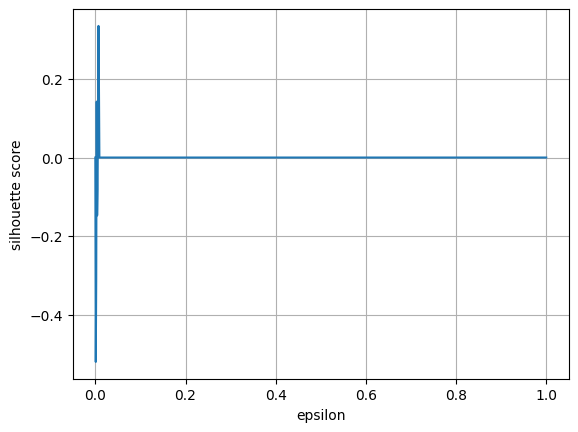

In [ ]:
import matplotlib.pyplot as plt
plt.xlabel('epsilon')
plt.ylabel('silhouette score')
plt.plot(eps_arr, scores)
plt.grid(True)

In [ ]:
eps_arr = np.linspace(0.00001, 0.02, num=1000, endpoint=True)
scores = []
for eps in tqdm(eps_arr):
    pred = DBSCAN(eps=eps).fit_predict(X)
    if len(np.unique(pred)) > 1:
        scores.append(silhouette_score(X, pred))
    else:
        scores.append(0.0)

100%|██████████| 1000/1000 [00:15<00:00, 64.31it/s]


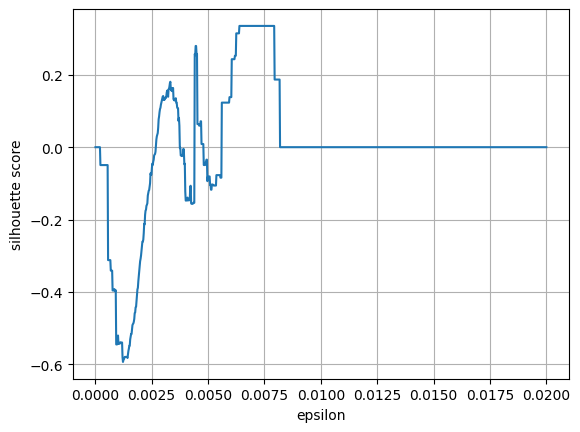

In [ ]:
plt.xlabel('epsilon')
plt.ylabel('silhouette score')
plt.plot(eps_arr, scores)
plt.grid(True)

Оптимальное значение silhouette score достигается при epsilon = 0.0075 для DBSCAN

In [ ]:
kmeans_best = KMeans(n_clusters=7).fit_predict(X)
graph_best = GraphClustering(n_clusters=6, n_components=2).fit_predict(adjacency_matrix)
dbscan_best = DBSCAN(eps=0.0075).fit_predict(X)

In [ ]:
draw_clustered_map(data, kmeans_best)

In [ ]:
draw_clustered_map(data, graph_best)

In [ ]:
draw_clustered_map(data, dbscan_best)

**Ваш ответ здесь:**

KMeans:
Best score 0.4210836642848658 is achieved using 7 clusters

Graph Clustering:
Best score 0.23926818491119128 is achieved using 6 clusters with 2 n_components

DBSCAN:
Оптимальное значение silhouette score достигается при epsilon = 0.0075 для DBSCAN. При таком epsilon silhouette_score чуть меньше 0.4.

визуально кажется, что KMeans с оптимальными параметрами справился с задачей лучше, чем все остальные модели, а хуже всего проявил себя алгоритм спектральной кластеризации (слишком перемешанные классы, что подтверждается низким silhouette_score)

-----

## Часть 2. Тематическое моделирование текстов

В этой части мы познакомимся с одной из самых популярных задач обучения без учителя &mdash; с задачей тематического моделирования текстов. Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. Фактически, мы будем решать задачу, похожую на кластеризацию текстов: отличие в том, что нас будет интересовать не только разбиение текстов на группы, но и выделение ключевых слов, определяющих каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [2]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
1289,politics,394.txt,Economy focus for election battle,Britain's economic future will be at the hear...
1872,tech,049.txt,Domain system scam fear,A system to make it easier to create website ...
1044,politics,149.txt,Blair returns from peace mission,Prime Minister Tony Blair has arrived back fr...
654,entertainment,145.txt,Sir Paul rocks Super Bowl crowds,Sir Paul McCartney wowed fans with a live min...
134,business,135.txt,Feta cheese battle reaches court,A row over whether only Greece should be allo...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть🙈, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [3]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN

from tqdm import tqdm
from sklearn.metrics import silhouette_score
import warnings
warnings.filterwarnings("ignore")

In [4]:
#pip install nltk

In [5]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [6]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [7]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [8]:
!unzip /usr/share/nltk_data/corpora/wordnet.zip -d /usr/share/nltk_data/corpora/

unzip:  cannot find or open /usr/share/nltk_data/corpora/wordnet.zip, /usr/share/nltk_data/corpora/wordnet.zip.zip or /usr/share/nltk_data/corpora/wordnet.zip.ZIP.


In [9]:
data['raw_text'] = data.apply(lambda row: row.title + row.content, axis=1)
data['text'] = data.apply(lambda row: preprocess(row.raw_text), axis=1)

Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [10]:
#pip install wordcloud

In [11]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=500, height=300):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)

    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

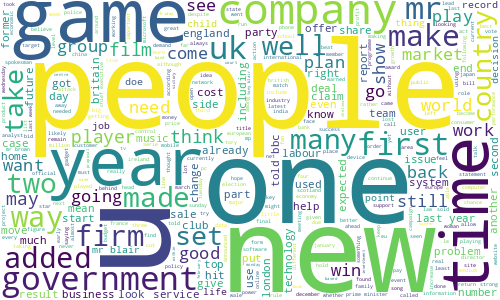

In [12]:
draw_wordcloud(data.text)

-----

**Задание 2.1 (1 балл).**

* **(0.5 балла)** Обучите алгоритм K-Means на tf-idf представлениях текстов.
* **(0.25 балла)** Постройте облака тегов для текстов из разных кластеров.
* **(0.25 балла)** (?) Получились ли темы интерпретируемыми? (?) Попробуйте озаглавить каждую тему.

**Подсказки:**
* Можно использовать готовую реализацию tf-idf векторайзера из sklearn
* При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова.
* Воздержитесь от использования N-грамм при обучении tf-idf.
* Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8).

**Ключевые слова:**
* *TfidfVectorizer*

In [13]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(min_df=10)
tfidf = vectorizer.fit_transform(data.text)

In [14]:
kmeans_model = KMeans()
kmeans_pred = kmeans_model.fit_predict(tfidf)

In [15]:
n_topics = len(np.unique(kmeans_pred))
n_topics

8

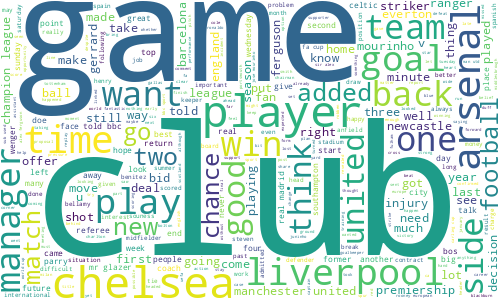

In [16]:
draw_wordcloud(data[kmeans_pred == 0].text)

1. Можно однозначно сказать, что основная тема текстов в первом кластере - спорт, в основном футбол.

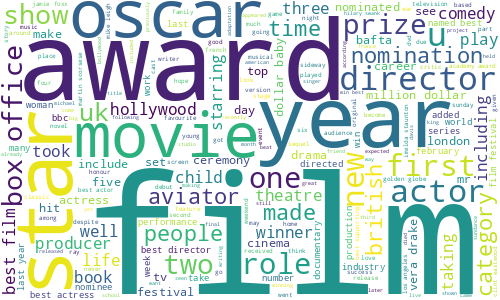

In [17]:
draw_wordcloud(data[kmeans_pred == 1].text)

2. Тема второго кластера - кинематограф

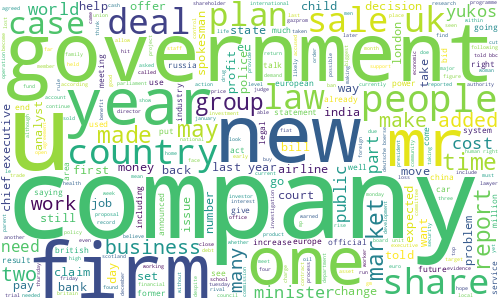

In [18]:
draw_wordcloud(data[kmeans_pred == 2].text)

3. Тексты в третьем кластере посвящены деловым новостям (экономике и политике).

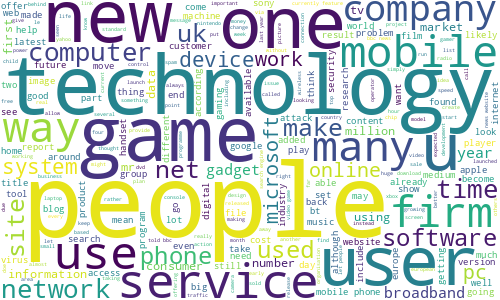

In [19]:
draw_wordcloud(data[kmeans_pred == 3].text)

4. Этот кластер - о цифровых технологиях.

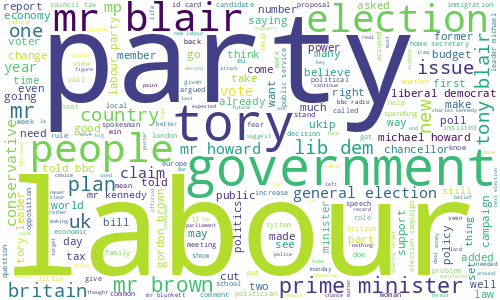

In [20]:
draw_wordcloud(data[kmeans_pred == 4].text)

5. В пятом кластере тексты о политике.

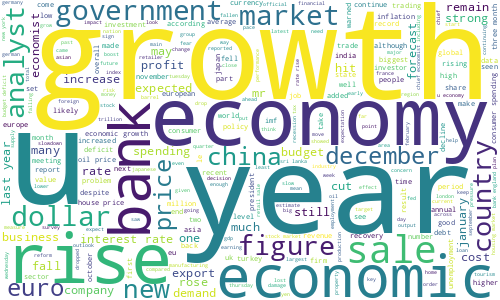

In [21]:
draw_wordcloud(data[kmeans_pred == 5].text)

6. В этом кластере тексты об экономике.

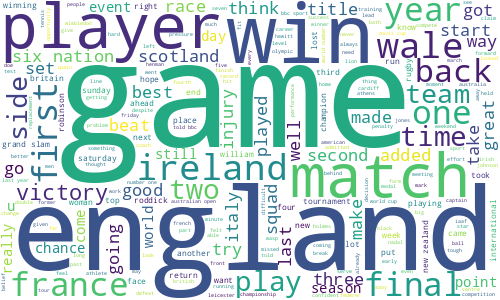

In [22]:
draw_wordcloud(data[kmeans_pred == 6].text)

7. Данный кластер объединяет спортивная тематика и группировка по странам - наверное, речь в текстах о международных соревнованиях с участием сборных

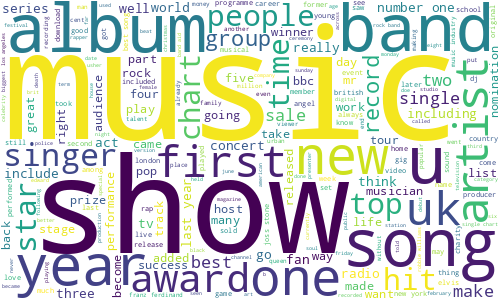

In [23]:
draw_wordcloud(data[kmeans_pred == 7].text)

8. Тексты в последнем кластере о музыке, популярных группах, песнях и событиях в музыкальной сфере.

**Ваш ответ здесь:**

Темы кластеров
1. Спорт

2. Кинематограф

3. Деловые новости

4. Цифровые новости

5. Политика

6. Экономика

7. Спорт (скорее между сборными государств)

8. Музыка

-----

**Задание 2.2 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера (`kmeans.cluster_centers_`).

* **(0.3 балла)** Попробуйте взять центры кластеров и посмотреть на слова, для которых значения соответствующих им признаков tf-idf максимальны.
* **(0.2 балла)** (?) Согласуются ли полученные слова с облаками тегов из прошлого задания?

In [24]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

items = np.array(vectorizer.get_feature_names_out())
centers = kmeans_model.cluster_centers_
main_words = items[centers.argmax(axis=1)]
for i in range(len(main_words)):
    print(i, main_words[i])

0 club
1 film
2 company
3 mobile
4 mr
5 growth
6 england
7 music


**Ваш ответ здесь:**

Получившиеся центры в целом согласуются с выделенными вручную темами текстов. По крайней мере, если есть знание задним числом о темах в каждом кластере).

Хотя есть и неочевидные центры:
Наверное, самое неочевидное - mr для политического кластера и england в теме про соревнования.

-----

**Задание 2.3 (1.5 балла).** В первой части мы сравнили три разных алгоритма кластеризации на географических данных. Проделаем то же самое для текстовых данных (в качестве признакого описания снова используем tf-idf).

* п.1 Получите три разбиения на кластеры с помощью алгоритмов K-Means, DBSCAN и спектральной кластеризации.
 * **(0.3 балла)** При этом для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров;
 * **(0.5 балла)** Подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.
* п.2 **(0.5 балла)** Обучите двухмерные t-SNE ([Почитать можно тут, часть 2](https://github.com/esokolov/ml-course-hse/blob/master/2020-fall/lecture-notes/lecture11-unsupervised.pdf), а также посмотреть непосредственно в [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html)) представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом.
* п.3 **(0.2 балла)** (?) Прокомментируйте получившиеся результаты. (?) Какой баланс кластеров получился у разных методов? (?) Соотносятся ли визуализации для текстов с визуализациями для географических данных?


**Замечания:**
* В этом задании используйте реализации спектральной кластеризации и t-SNE из `sklearn`
* В п.2 Лучше всего расположить визуализации на одном графике на трех разных сабплотах.

**Подсказка:**
* Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
kmeans_model = KMeans(8)
kmeans_preds = kmeans_model.fit_predict(tfidf)

In [ ]:
from sklearn.cluster import SpectralClustering

cluster_model = SpectralClustering(n_clusters=8)
cluster_preds = cluster_model.fit_predict(tfidf)

In [ ]:
eps_arr = [0.001, 0.01, 0.05, 0.1, 0.2, 0.5, 0.7, 0.8, 1.0]
n_clusters = []
for eps_ in tqdm(eps_arr):
    dbscan_model = DBSCAN(eps=eps_)
    dbscan_preds = dbscan_model.fit_predict(tfidf)
    n_cur = np.sum(np.unique(dbscan_preds) != -1)
    n_clusters.append(n_cur)

100%|██████████| 9/9 [05:05<00:00, 33.98s/it]


In [ ]:
for i in range(len(eps_arr)):
    print('eps =', eps_arr[i], 'n_clusters =', n_clusters[i])

eps = 0.001 n_clusters = 0

eps = 0.01 n_clusters = 0

eps = 0.05 n_clusters = 0

eps = 0.1 n_clusters = 0

eps = 0.2 n_clusters = 0

eps = 0.5 n_clusters = 0

eps = 0.7 n_clusters = 1

eps = 0.8 n_clusters = 6

eps = 1.0 n_clusters = 37


In [ ]:
eps_arr = [0.825, 0.85, 0.875, 0.9, 0.925, 0.95, 0.975]
n_clusters = []
for eps_ in tqdm(eps_arr):
    dbscan_model = DBSCAN(eps=eps_)
    dbscan_preds = dbscan_model.fit_predict(tfidf)
    n_cur = np.sum(np.unique(dbscan_preds) != -1)
    n_clusters.append(n_cur)
for i in range(len(eps_arr)):
    print('eps =', eps_arr[i], 'n_clusters =', n_clusters[i])

100%|██████████| 7/7 [03:57<00:00, 33.90s/it]

eps = 0.825 n_clusters = 8

eps = 0.85 n_clusters = 8

eps = 0.875 n_clusters = 10

eps = 0.9 n_clusters = 15

eps = 0.925 n_clusters = 18

eps = 0.95 n_clusters = 28

eps = 0.975 n_clusters = 35


In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, init='random')
coords = tsne.fit_transform(tfidf)

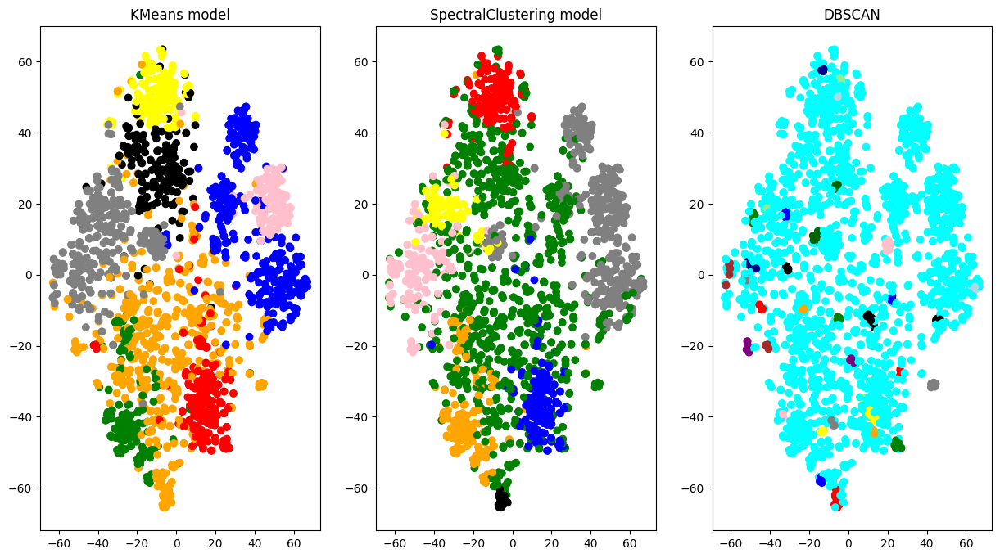

In [ ]:
colors = np.array(['red', 'green', 'blue', 'grey', 'black', 'yellow', 'orange', 'pink', 'lightblue', 'darkblue', 'lightgreen', 'darkgreen', 'purple', 'brown', 'cyan',
                  'red', 'green', 'blue', 'grey', 'black', 'yellow', 'orange', 'pink', 'lightblue', 'darkblue', 'lightgreen', 'darkgreen', 'purple', 'brown', 'cyan',
                  'red', 'green', 'blue', 'grey', 'black', 'yellow', 'orange', 'pink', 'lightblue', 'darkblue', 'lightgreen', 'darkgreen', 'purple', 'brown', 'cyan'])
coords_x, coords_y = coords[:, 0], coords[:, 1]
plt.figure(figsize=(15, 8))
plt.subplot(1,3,1)
plt.title('KMeans model')
plt.scatter(coords_x, coords_y, c=colors[kmeans_model.labels_])
plt.subplot(1,3,2)
plt.title('SpectralClustering model')
plt.scatter(coords_x, coords_y, c=colors[cluster_model.labels_])
plt.subplot(1,3,3)
plt.title('DBSCAN')
plt.scatter(coords_x, coords_y, c=colors[dbscan_model.labels_])
plt.show()

**Ваш ответ здесь:**
Во всех случаях выделяются отдельные облака точек в каждом кластере, что не может не радовать. Хотя облака и перемешаны у KMeans  и Спектральной кластеризации.

Кластеры кажутся хорошо сбалансированными в случае применения KMeans и спектральной кластеризации.
Можно заметить, что у DBSCAN алгоритма очень большое число текстов попало в один (бирюзовый цвет) кластер, похоже, это тексты, не отнесенные алгоритмом ни к одному кластеру.

- KMeans визуально хорошо работает как в прошлой задаче с остановками, так и тут, при кластеризации текстов.
- В данном пункте хорошо себя проявила спектральная кластеризация, чего мне не удалось добиться от нее в предыдущем пункте.
- DBSCAN, похоже, плохо работает для обеих задач в таком виде, в котором мы их применяли.

-----

**Задание 2.4 (1.5 балла).**

* **(0.5 балла)**  Обучите модель латентного размещения Дирихле (LDA).
* **(0.5 балла)**  Придумайте как превратить распределение тем для текста в номер его кластера. Опишите текстом (?) и приведите код и результаты его работы
* **(0.5 балла)** Возьмите параметр `n_components` у LDA в 2-3 раза больше, чем число кластеров для K-Means, и вновь посмотрите на темы. (?) Получились ли темы более узкими от такого нововведения? Постройте облака тегов для нескольких наиболее удачных тем.

**Замечания:**
* Реализацию LDA во всех заданиях используйте из `sklearn` (LatentDirichletAllocation)

**Подсказка:**
* Не забудьте, что LDA работает с мешком слов, а не с tf-idf признаками.

**Ключевые слова:**
* *CountVectorizer,  LatentDirichletAllocation*

In [25]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer

lda_model = LatentDirichletAllocation(8)
bag_of_words = CountVectorizer(min_df=0.01).fit_transform(data['text'])

Для того чтобы из распределения получить номер кластера для текста, можно взять индекс элемента распределения с максимальным значением. Это означает, что мы выбираем тот кластер, для которого модель предсказывает большую вероятность.

In [26]:
lda_probs = lda_model.fit_transform(bag_of_words)
lda_labels = np.argmax(lda_probs, axis=1)
print(np.unique(lda_labels))

[0 1 2 3 4 5 6 7]


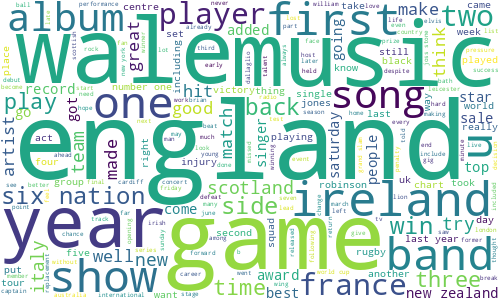

In [27]:
draw_wordcloud(data.text[lda_labels == 0])

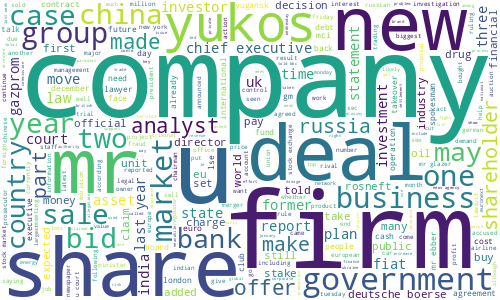

In [28]:
draw_wordcloud(data.text[lda_labels == 1])

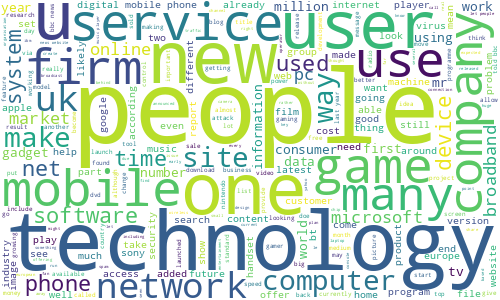

In [29]:
draw_wordcloud(data.text[lda_labels == 2])

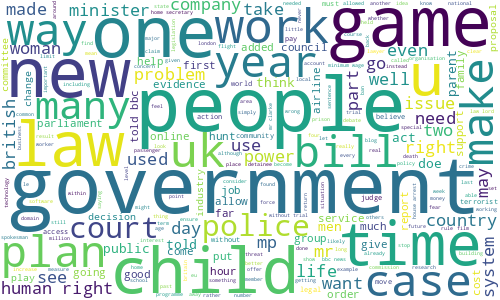

In [30]:
draw_wordcloud(data.text[lda_labels == 3])

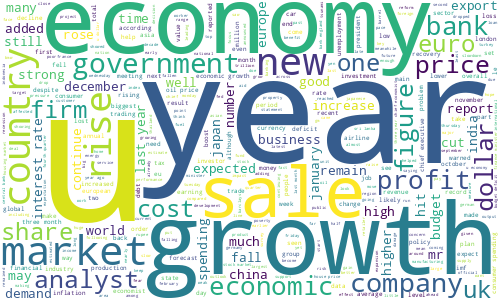

In [31]:
draw_wordcloud(data.text[lda_labels == 4])

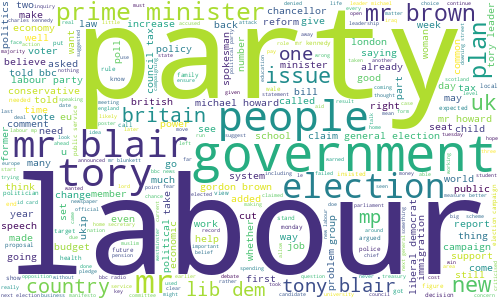

In [32]:
draw_wordcloud(data.text[lda_labels == 5])

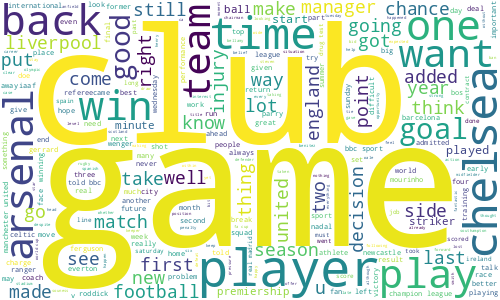

In [33]:
draw_wordcloud(data.text[lda_labels == 6])

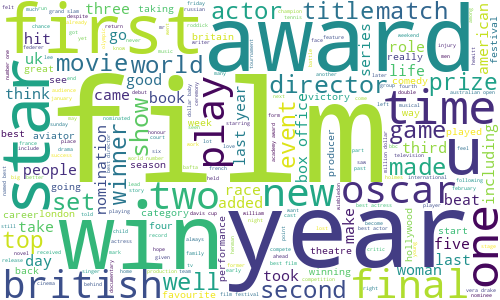

In [34]:
draw_wordcloud(data.text[lda_labels == 7])

Получились темы:

1. Музыка (и, возможно, немного о спорте)

2. Экономика

3. Технологии, цифровые технологии

4. Политика (внутренняя)

5. Экономика

6. Политика

7. Спорт

8. Кинематограф и события в мире кино

Возьмем число компонент для LDA, равное 24

In [35]:
big_lda = LatentDirichletAllocation(24)
big_probs = big_lda.fit_transform(bag_of_words)
big_labels = np.argmax(big_probs, axis=1)

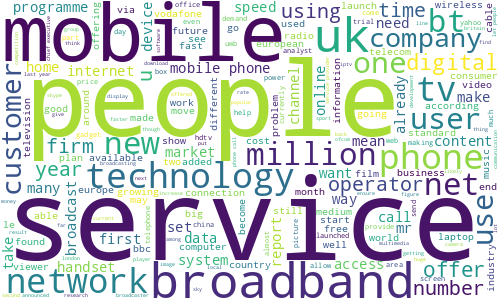

In [36]:
draw_wordcloud(data.text[big_labels == 0])

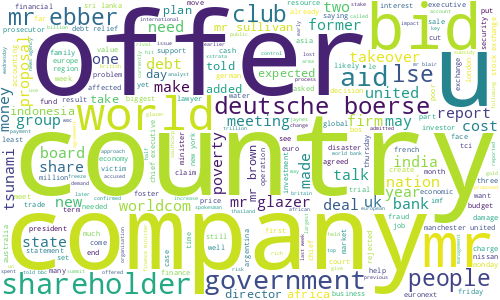

In [37]:
draw_wordcloud(data.text[big_labels == 1])

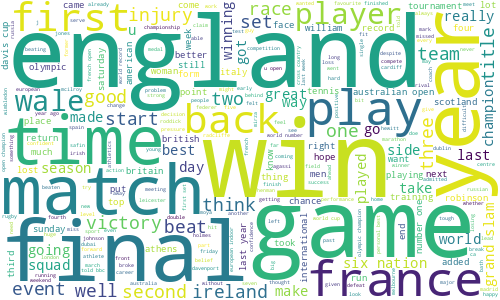

In [38]:
draw_wordcloud(data.text[big_labels == 2])

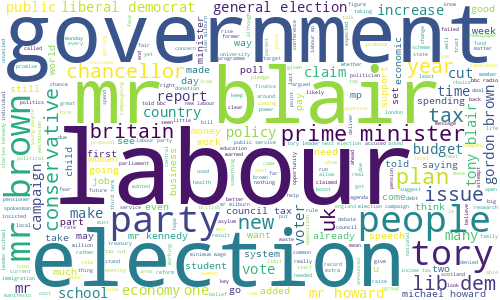

In [39]:
draw_wordcloud(data.text[big_labels == 3])

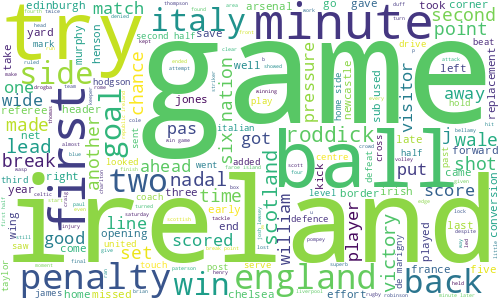

In [40]:
draw_wordcloud(data.text[big_labels == 4])

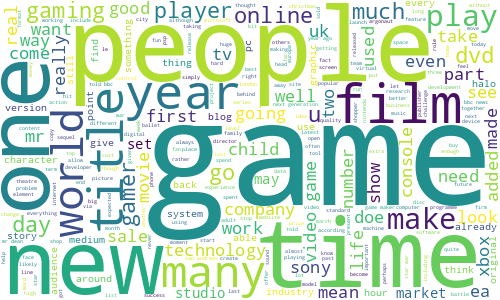

In [41]:
draw_wordcloud(data.text[big_labels == 5])

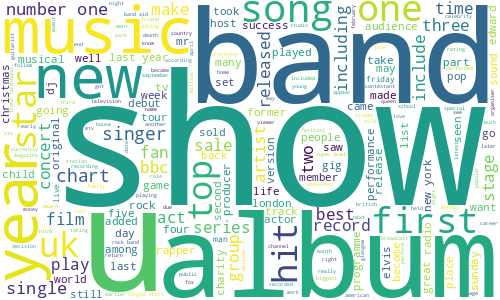

In [42]:
draw_wordcloud(data.text[big_labels == 6])

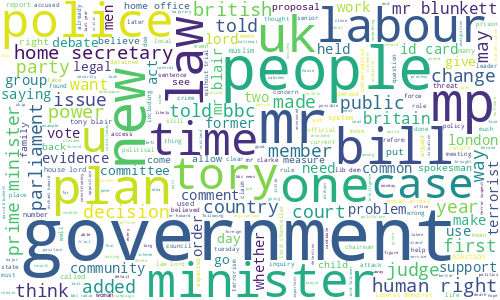

In [43]:
draw_wordcloud(data.text[big_labels == 7])

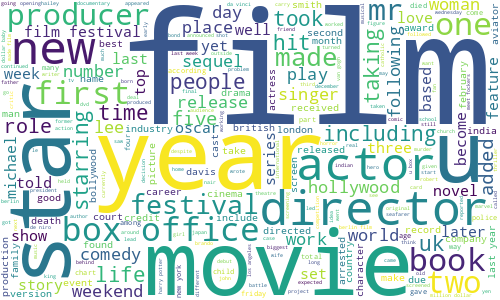

In [44]:
draw_wordcloud(data.text[big_labels == 8])

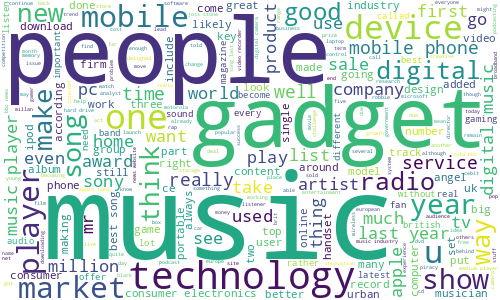

In [45]:
draw_wordcloud(data.text[big_labels == 9])

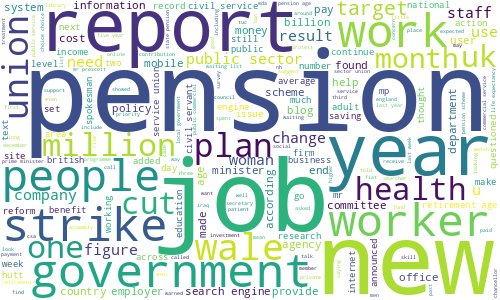

In [46]:
draw_wordcloud(data.text[big_labels == 10])

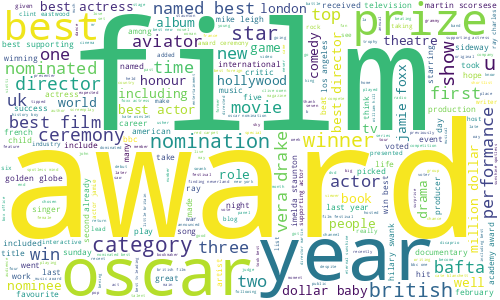

In [47]:
draw_wordcloud(data.text[big_labels == 11])

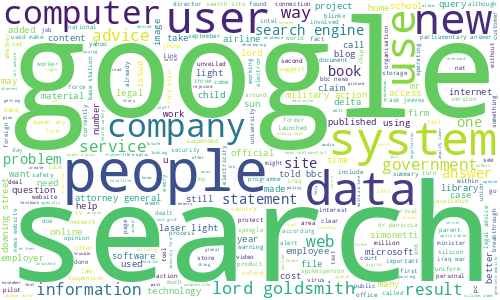

In [48]:
draw_wordcloud(data.text[big_labels == 12])

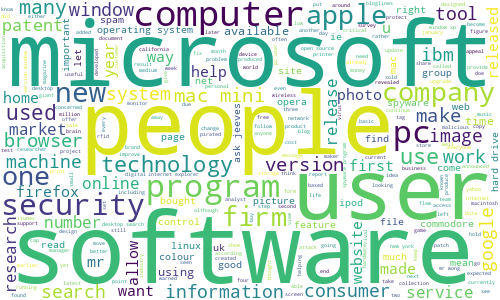

In [49]:
draw_wordcloud(data.text[big_labels == 13])

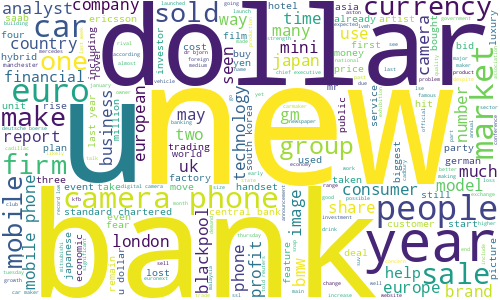

In [50]:
draw_wordcloud(data.text[big_labels == 14])

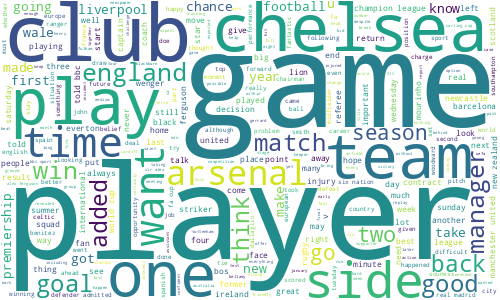

In [51]:
draw_wordcloud(data.text[big_labels == 15])

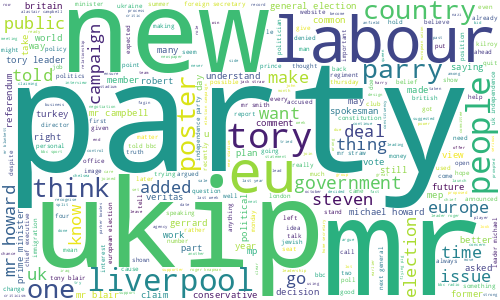

In [52]:
draw_wordcloud(data.text[big_labels == 16])

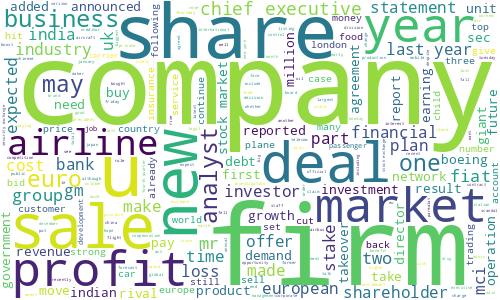

In [53]:
draw_wordcloud(data.text[big_labels == 17])

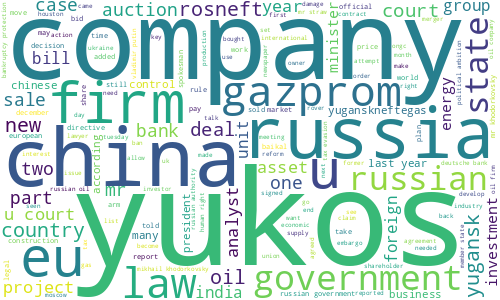

In [54]:
draw_wordcloud(data.text[big_labels == 18])

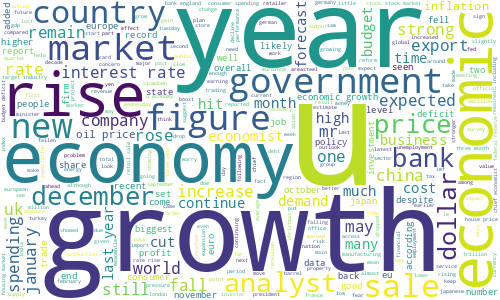

In [55]:
draw_wordcloud(data.text[big_labels == 19])

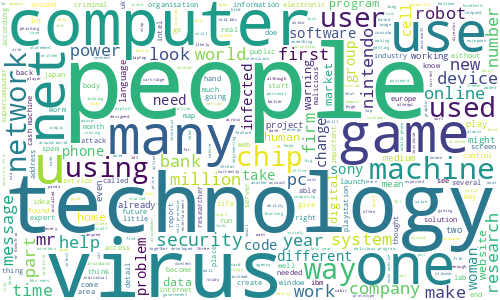

In [56]:
draw_wordcloud(data.text[big_labels == 20])

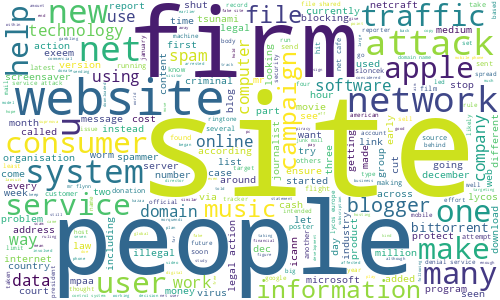

In [57]:
draw_wordcloud(data.text[big_labels == 21])

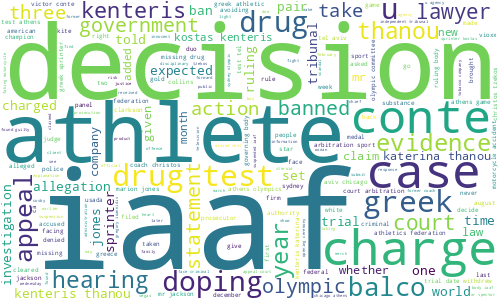

In [58]:
draw_wordcloud(data.text[big_labels == 22])

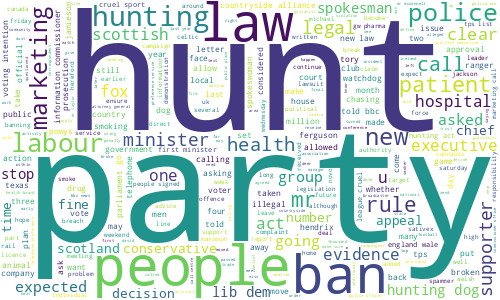

In [59]:
draw_wordcloud(data.text[big_labels == 23])

**Ваш ответ здесь:**

Получившиеся 24 темы:

1. Цифровые технологии

2. Экономика

3. Спорт

4. Политика

5. Спорт

6. Сложно выделить тему

7. Музыка

8. Внутренняя политика

9. Кинематограф

10. Мобильные технологии

11. Экономика

12. Кинематограф

13. Тексты о цифровой индустрии, в основном об интернете и поиске.

14. Цифровые технологии

15. Экономика

16. Футбол

17. Политика

18. Экономика

19. Российские энергетические компании

20. Экономика на уровне государства

21. Цифровые технологии, кибербезопасность

22. Цифровые технологии

23. Спорт, допинг, контроль спортсменов.

24. Внутренняя политика

однозначно, темы стали более узкими и в то же время не потеряли своей четкости: только в одном из 24 случаев не удалось легко определить общую тему кластера.

-----

## Часть 3. Transfer learning для задачи классификации текстов

**Замечание для всей части 3:**
* Для возможности получения **полного балла** accuracy всех алгоритмов на тесте должны быть не ниже 0.75, а также хотя бы один из рассмотренных в этой части алгоритмов должен достигнуть точности не менее 0.95 на тесте.

**Задание 3.1 (0.5 балла).** Вспомним, что у нас есть разметка для тематик статей 🌚🌝. Попробуем обучить классификатор поверх unsupervised-представлений для текстов. Рассмотрите три модели:

* Логистическая регрессия на tf-idf признаках
* K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
* Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

* **(0.4 балла)** Разделите выборку на обучающую и тестовую, замерьте accuracy на обоих выборках для всех трех моделей. Параметры всех моделей возьмите равными значениям по умолчанию.
* **(0.1 балла)** (?) У какой модели получилось лучшее качество? (?) С чем это связано?

**Подсказка:**
* Во второй модели расстояния до центров кластеров можно получиться при помощи метода KMeans.transform

**Ключевые слова:**
* *OrdinalEncoder, TfidfVectorizer, CountVectorizer, train_test_split, KMeans.transform*

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(data['text'], data['category'], test_size=0.25)

In [ ]:
vectorizer = TfidfVectorizer()
tfidf_train = vectorizer.fit_transform(X_train)
tfidf_test = vectorizer.transform(X_test)

In [ ]:
from sklearn.linear_model import LogisticRegression
logreg_model = LogisticRegression()
logreg_model.fit(tfidf_train, y_train)

LogisticRegression()

In [ ]:
preds = logreg_model.predict(tfidf_test)
print('Test accuracy for usual LogReg:', np.mean(y_test == preds))
preds = logreg_model.predict(tfidf_train)
print('Train accuracy for usual LogReg:', np.mean(y_train == preds))

Test accuracy for usual LogReg: 0.9838420107719928

Train accuracy for usual LogReg: 0.9964028776978417


In [ ]:
kmeans_model = KMeans()
dist_train = kmeans_model.fit_transform(tfidf_train)
dist_test = kmeans_model.transform(tfidf_test)

In [ ]:
logreg_model = LogisticRegression().fit(dist_train, y_train)
preds = logreg_model.predict(dist_test)
print('Test accuracy for KMeans:', np.mean(y_test == preds))
preds = logreg_model.predict(dist_train)
print('Train accuracy for KMeans:', np.mean(y_train == preds))

Test accuracy for KMeans: 0.8186714542190305

Train accuracy for KMeans: 0.789568345323741


In [ ]:
vectorizer = CountVectorizer()
count_train, count_test = vectorizer.fit_transform(X_train), vectorizer.transform(X_test)
lda_model = LatentDirichletAllocation()
probs_train = lda_model.fit_transform(count_train)
probs_test = lda_model.transform(count_test)

In [ ]:
logreg_model = LogisticRegression().fit(probs_train, y_train)
preds = logreg_model.predict(probs_test)
print('Train accuracy for LDA:', np.mean(y_train==logreg_model.predict(probs_train)))
print('Test accuracy for LDA:', np.mean(y_test==preds))

Train accuracy for LDA: 0.8806954436450839

Test accuracy for LDA: 0.9353680430879713


**Ваш ответ здесь:**

Лучшее качество как на обучающей, так и на тестовой выборке, получилось с большим отрывом у логистической регрессии. Однако другие модели тоже проявили себя неплохо. Хуже всего показала себя модель KMeans. Её проигрыш модели LDA можно связать с тем, что интуитивно кажется неплохой идеей вычислять вероятности принадлежности текста всем кластерам и выбирать кластер с наибольшей вероятностью, как это делается в LDA.
Логистическая регрессия также буквально предсказывает вероятности, и, думаю, с этим можно связать лучшее качество этой модели в данной задаче.

-----

**Задание 3.2 (1.5 балла).** Теперь просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 5:65:30. Будем называть части, соответственно, размеченный трейн, неразмеченный трейн и валидация.

Все unsupervised-алгоритмы (векторайзеры (tf-idf, bag_of_words) и алгоритмы кластеризации (KMeans)) запускайте на всем трейне целиком (размеченном и неразмеченном, суммарно 70%), а итоговый классификатор обучайте только на размеченном трейне (5%).

* **(1.2 балла)** Подберите гиперпараметры моделей по качеству на валидации (30%), а затем оцените качество на тестовой выборке (которая осталась от прошлого задания). Не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации.
* **(0.3 балла)** (?) Как изменились результаты по сравнению с обучением на полной разметке? (?) Сделайте выводы.

**Пояснение:**
* Тестовую выборку возьмите из задания 3.1. А разделять надо тренировочную из 3.1
* Обучаете векторайзер на 70%, применяете векторайзер к 5%, и на этих 5% уже обучаете классификатор.
* Итак, берем 3 варианта обучения из задания 3.1. Вы должны:
 * 1-я модель. Подобрать оптимальный гиперпараметр С у LogisticRegression на tf-idf признаках. Выбираем оптимальный параметр по валидационной выборке. Далее оцениваем обученную модель с оптимальном параметром на тесте.
 * 2-я модель. Шаг 1. Подобрать оптимальный гиперпараметр n_clusters у KMeans на tf-idf признаках: перебираем значения n_clusters и при каждом значении обучаем LogisticRegression на дефолтных параметрах (быть может с ограничением max_iter, об этом ниже). То есть классификатор в данном случае будет на одинаковых параметрах для всех представителей семейства алгоритмов KMeans. Далее выбираете оптимальный n_clusters по качеству классификатора на валидационной выборке. Шаг 2. Обучаете KMeans с оптимальным n_clusters и перебираете значение C у LogisticRegression. Также выбираете оптмальное по валидации. И только после двух подобранных оптимальных параметров выводите качество на тесте.
 * 3-я модель. Аналогично второй, только вместо KMeans --- LatentDirichletAllocation, а вместо tf-idf -- bag of words.

**Замечания:**
* Параметр $С$ у LogisticRegression перебирайте *по логарифмической сетке.* Обратите внимание, что $С$ НЕ перед регуляризатором, поэтому, скорее всего, наиболее оптимальными будут большие значения $C$. **Для возможности получения полного балла** переберите хотя бы 20 параметров, и затроньте значения в 1e-2 и 1e6 (по большей части значения должны лежать в этом отрезке)
* **Для возможности получения полного балла** параметр n_clusters у KMeans при переборе должен затрагивать значения в 10 и 1000 кластеров (по большей части значения должны лежать в этом отрезке), а также должно быть перебрано не менее 20 значений кластеров *(по линейной сетке)*
* **Для возможности получения полного балла** параметр n_components у LDA при переборе должен затрагивать значения в 5 и 14 (по большей части значения должны лежать в этом отрезке), а также должно быть перебрано не меньше 10 различных значений *(по линейной сетке)*

**Подсказка:**
* Может быть для ограничения времени обучения лучше будет ограничить параметр max_iter в LogisticRegression, равным, например, 1000

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
X_tr, X_val, y_tr, y_val = train_test_split(X_train, y_train, test_size=0.3, random_state=42)
ratio = 0.65 / 0.7
print(ratio)
X_marked, X_unmarked, y_marked, y_unmarked = train_test_split(X_tr, y_tr, test_size=ratio, random_state=42)

0.9285714285714287


In [ ]:
X_marked.shape, X_unmarked.shape

((83,), (1084,))

In [ ]:
from sklearn.preprocessing import OrdinalEncoder
tfidfVec = TfidfVectorizer().fit(X_tr)

tfidf_train = tfidfVec.transform(X_train)
tfidf_marked = tfidfVec.transform(X_marked)
tfidf_val = tfidfVec.transform(X_val)
tfidf_test = tfidfVec.transform(X_test)

In [ ]:
Cs = np.logspace(-2, 6, num = 20, endpoint=True, base = 10)
acc_dict = {}
for c in tqdm(Cs):
    logreg_model = LogisticRegression(C=c).fit(tfidf_marked, y_marked)
    preds = logreg_model.predict(tfidf_val)
    acc_dict[c] = np.mean(y_val == preds)

100%|██████████| 20/20 [00:21<00:00,  1.08s/it]


In [ ]:
acc_dict

{0.01: 0.22355289421157684,
 0.026366508987303583: 0.22355289421157684,
 0.06951927961775606: 0.22355289421157684,
 0.18329807108324356: 0.2954091816367265,
 0.4832930238571752: 0.6107784431137725,
 1.2742749857031335: 0.7544910179640718,
 3.359818286283781: 0.812375249500998,
 8.858667904100823: 0.8323353293413174,
 23.357214690901213: 0.844311377245509,
 61.584821106602604: 0.8542914171656687,
 162.3776739188721: 0.8682634730538922,
 428.13323987193957: 0.8762475049900199,
 1128.8378916846884: 0.8842315369261478,
 2976.3514416313133: 0.8842315369261478,
 7847.5997035146065: 0.8882235528942116,
 20691.3808111479: 0.8942115768463074,
 54555.947811685146: 0.8942115768463074,
 143844.988828766: 0.8942115768463074,
 379269.0190732246: 0.8862275449101796,
 1000000.0: 0.8383233532934131}

In [ ]:
print('Оптималный параметр C и точность на валидации при нем:', 54555.947811685146, 0.8942115768463074)

Оптималный параметр C и точность на валидации при нем: 54555.947811685146 0.8942115768463074


In [ ]:
logreg_best = LogisticRegression(C=379269.0190732246).fit(tfidf_marked, y_marked)
preds = logreg_best.predict(tfidf_test)
print('Точность логистической регрессии на тестовой выборке с лучшими параметрами:\n',
     np.mean(preds==y_test))

Точность логистической регрессии на тестовой выборке с лучшими параметрами:

 0.8976660682226212


In [ ]:
countVec = CountVectorizer().fit(X_tr)

count_train = countVec.transform(X_train)
count_marked = countVec.transform(X_marked)
count_val = countVec.transform(X_val)
count_test = countVec.transform(X_test)

In [ ]:
clusters_arr = np.arange(10, 1100, 50)
acc_dict = {}
for n_clusters in tqdm(clusters_arr):
    kmeans_model = KMeans(n_clusters).fit(count_train)
    kmeans_val = kmeans_model.transform(count_val)
    kmeans_marked = kmeans_model.transform(count_marked)
    logreg_model = LogisticRegression().fit(kmeans_marked, y_marked)
    preds_val = logreg_model.predict(kmeans_val)
    acc_dict[n_clusters] = np.mean(preds_val==y_val)

100%|██████████| 22/22 [48:10<00:00, 131.38s/it]


In [ ]:
acc_dict

{10: 0.846307385229541,
 60: 0.9161676646706587,
 110: 0.8702594810379242,
 160: 0.9281437125748503,
 210: 0.8882235528942116,
 260: 0.8702594810379242,
 310: 0.8483033932135728,
 360: 0.8702594810379242,
 410: 0.9281437125748503,
 460: 0.9141716566866267,
 510: 0.9281437125748503,
 560: 0.8802395209580839,
 610: 0.9041916167664671,
 660: 0.8483033932135728,
 710: 0.9421157684630739,
 760: 0.9181636726546906,
 810: 0.9301397205588823,
 860: 0.8602794411177644,
 910: 0.8702594810379242,
 960: 0.8942115768463074,
 1010: 0.9001996007984032,
 1060: 0.846307385229541}

In [ ]:
optimal, score = max(acc_dict.items(), key=lambda x: x[1])
print('Оптимальный параметр n_clusters и точность на валидации при нем:',optimal, score)

Оптимальный параметр n_clusters и точность на валидации при нем: 710 0.9421157684630739


In [ ]:
Cs = np.logspace(-2, 6, num = 20, endpoint=True, base = 10)
acc_dict = {}
for c in tqdm(Cs):
    kmeans_model = KMeans(n_clusters=optimal).fit(count_train)
    kmeans_marked = kmeans_model.transform(count_marked)
    kmeans_val = kmeans_model.transform(count_val)
    logreg_model = LogisticRegression(C=c).fit(kmeans_marked, y_marked)
    preds = logreg_model.predict(kmeans_val)
    acc_dict[c] = np.mean(y_val == preds)

100%|██████████| 20/20 [55:36<00:00, 166.82s/it]


In [ ]:
acc_dict

{0.01: 0.8942115768463074,
 0.026366508987303583: 0.9101796407185628,
 0.06951927961775606: 0.8982035928143712,
 0.18329807108324356: 0.8702594810379242,
 0.4832930238571752: 0.8842315369261478,
 1.2742749857031335: 0.8363273453093812,
 3.359818286283781: 0.9021956087824351,
 8.858667904100823: 0.8522954091816367,
 23.357214690901213: 0.8542914171656687,
 61.584821106602604: 0.8922155688622755,
 162.3776739188721: 0.8922155688622755,
 428.13323987193957: 0.8782435129740519,
 1128.8378916846884: 0.874251497005988,
 2976.3514416313133: 0.846307385229541,
 7847.5997035146065: 0.8043912175648703,
 20691.3808111479: 0.872255489021956,
 54555.947811685146: 0.9001996007984032,
 143844.988828766: 0.8363273453093812,
 379269.0190732246: 0.8483033932135728,
 1000000.0: 0.8862275449101796}

In [ ]:
optimal_c, score = max(acc_dict.items(), key=lambda x: x[1])
print('Оптимальный параметр C и точность на валидации при нем:',optimal_c, score)

Оптимальный параметр C и точность на валидации при нем: 0.026366508987303583 0.9101796407185628


In [ ]:
optimal_clusters = optimal
kmeans_best = KMeans(n_clusters = optimal_clusters).fit(count_train)
kmeans_preds = kmeans_best.transform(count_marked)
logreg_best = LogisticRegression(C=optimal_c).fit(kmeans_preds, y_marked)

kmeans_preds = kmeans_best.transform(count_test)
logreg_preds = logreg_best.predict(kmeans_preds)
acc = np.mean(logreg_preds == y_test)
print('Точность при оптимальных параметрах KMeans и LogisticRegression на тесте:\n', acc)

Точность при оптимальных параметрах KMeans и LogisticRegression на тесте:

 0.8671454219030521


In [ ]:
clusters_arr = np.arange(10, 1100, 50)
acc_dict = {}
for n_clusters in tqdm(clusters_arr):
    lda_model = LatentDirichletAllocation(n_clusters).fit(count_train)
    lda_val = lda_model.transform(count_val)
    lda_marked = lda_model.transform(count_marked)
    logreg_model = LogisticRegression().fit(lda_marked, y_marked)
    preds_val = logreg_model.predict(lda_val)
    acc_dict[n_clusters] = np.mean(preds_val==y_val)
print(acc_dict)

100%|██████████| 22/22 [59:38<00:00, 162.68s/it]

{10: 0.8702594810379242, 60: 0.7724550898203593, 110: 0.5868263473053892, 160: 0.6187624750499002, 210: 0.5409181636726547, 260: 0.4550898203592814, 310: 0.4171656686626746, 360: 0.34331337325349304, 410: 0.3193612774451098, 460: 0.3153692614770459, 510: 0.2994011976047904, 560: 0.2894211576846307, 610: 0.26746506986027946, 660: 0.25948103792415167, 710: 0.25349301397205587, 760: 0.2654690618762475, 810: 0.24550898203592814, 860: 0.25948103792415167, 910: 0.25948103792415167, 960: 0.2554890219560878, 1010: 0.25948103792415167, 1060: 0.25948103792415167}


In [ ]:
optimal, score = max(acc_dict.items(), key=lambda x: x[1])
print('Оптимальный параметр n_clusters и точность на валидации при нем:',optimal, score)

Оптимальный параметр n_clusters и точность на валидации при нем: 10 0.8702594810379242


In [ ]:
Cs = np.logspace(-2, 6, num = 20, endpoint=True, base = 10)
acc_dict = {}
for c in tqdm(Cs):
    lda_model = LatentDirichletAllocation(n_components=optimal).fit(count_train)
    lda_marked = lda_model.transform(count_marked)
    lda_val = lda_model.transform(count_val)
    logreg_model = LogisticRegression(C=c).fit(lda_marked, y_marked)
    preds = logreg_model.predict(lda_val)
    acc_dict[c] = np.mean(y_val == preds)

100%|██████████| 20/20 [03:27<00:00, 10.39s/it]


In [ ]:
acc_dict

{0.01: 0.22355289421157684,
 0.026366508987303583: 0.5189620758483033,
 0.06951927961775606: 0.5988023952095808,
 0.18329807108324356: 0.7145708582834331,
 0.4832930238571752: 0.8263473053892215,
 1.2742749857031335: 0.8982035928143712,
 3.359818286283781: 0.9001996007984032,
 8.858667904100823: 0.8483033932135728,
 23.357214690901213: 0.8582834331337326,
 61.584821106602604: 0.8423153692614771,
 162.3776739188721: 0.8942115768463074,
 428.13323987193957: 0.8702594810379242,
 1128.8378916846884: 0.872255489021956,
 2976.3514416313133: 0.8582834331337326,
 7847.5997035146065: 0.8782435129740519,
 20691.3808111479: 0.908183632734531,
 54555.947811685146: 0.7445109780439122,
 143844.988828766: 0.8762475049900199,
 379269.0190732246: 0.7864271457085829,
 1000000.0: 0.8383233532934131}

In [ ]:
optimal_c, score = max(acc_dict.items(), key=lambda x: x[1])
print('Оптимальный параметр C и точность на валидации при нем:',optimal_c, score)

Оптимальный параметр C и точность на валидации при нем: 20691.3808111479 0.908183632734531


In [ ]:
optimal_clusters = optimal
lda_best = LatentDirichletAllocation(n_components = optimal_clusters).fit(count_train)
lda_preds = lda_best.transform(count_marked)
logreg_best = LogisticRegression(C=optimal_c).fit(lda_preds, y_marked)

lda_preds = lda_best.transform(count_test)
logreg_preds = logreg_best.predict(lda_preds)
acc = np.mean(logreg_preds == y_test)
print('Точность при оптимальных параметрах LDA и LogisticRegression на тесте:\n', acc)

Точность при оптимальных параметрах LDA и LogisticRegression на тесте:

 0.8168761220825853


**Ваш ответ здесь:**
Точность логистической регрессии на тестовой выборке с лучшими параметрами:
 0.8976660682226212

Точность при оптимальных параметрах KMeans и LogisticRegression на тесте:
 0.8671454219030521

 Точность при оптимальных параметрах LDA и LogisticRegression на тесте:
 0.8168761220825853

Любопытно, но качество моделей несколько выровнялось друг относительно друга.
Логистическая регрессия - всё еще лидер, но все модели стали работать хуже. Это однозначно связано с большим числом неразмеченных данных в обучающей выборке. Но подбор параметров в какой-то мере скомпенсировал это падение точности.

-----

## Бонус

**Задание 4 (1 балл)**.

* **(Максимум 0.8 балла, 0.4 балла за каждый исследованный метод)** Разберитесь с semi-supervised методами, которые реализованы в `sklearn` и примените их к заданию 3.2.
* **(0.2 балла)** (?) Получилось ли добиться лучшего качества? (?) Сделайте выводы.

https://scikit-learn.org/stable/modules/semi_supervised.html
"scikit-learn provides two label propagation models: LabelPropagation and LabelSpreading. Both work by constructing a similarity graph over all items in the input dataset."

In [ ]:
data.head

<bound method NDFrame.head of       category filename                              title  \
0     business  001.txt  Ad sales boost Time Warner profit   
1     business  002.txt   Dollar gains on Greenspan speech   
2     business  003.txt  Yukos unit buyer faces loan claim   
3     business  004.txt  High fuel prices hit BA's profits   
4     business  005.txt  Pernod takeover talk lifts Domecq   
...        ...      ...                                ...   
2220      tech  397.txt   BT program to beat dialler scams   
2221      tech  398.txt    Spam e-mails tempt net shoppers   
2222      tech  399.txt            Be careful how you code   
2223      tech  400.txt    US cyber security chief resigns   
2224      tech  401.txt   Losing yourself in online gaming   

                                                content  \
0      Quarterly profits at US media giant TimeWarne...   
1      The dollar has hit its highest level against ...   
2      The owners of embattled Russian oil giant

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
from sklearn.semi_supervised import LabelPropagation, LabelSpreading
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(data['text'], data['category'], test_size=0.25)

X_tr, X_val, y_tr, y_val = train_test_split(X_train, y_train, test_size=0.3, random_state=42)
ratio = 0.65 / 0.7
print(ratio)
X_marked, X_unmarked, y_marked, y_unmarked = train_test_split(X_tr, y_tr, test_size=ratio, random_state=42)

0.9285714285714287


In [ ]:
X_united = np.hstack((X_marked, X_unmarked))
y_united = []
for i in y_marked.ravel():
    y_united.append(i)
y_united += [-1] * len(y_unmarked)
y_united = np.array(y_united)
X_united.shape, y_united.shape

((1167,), (1167,))

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfidfVec = TfidfVectorizer().fit(X_united)

tfidf_united = tfidfVec.transform(X_united)
tfidf_val = tfidfVec.transform(X_val)
tfidf_test = tfidfVec.transform(X_test)

In [ ]:
spreading_model = LabelSpreading().fit(tfidf_united.toarray(), y_united)
spreading_preds = spreading_model.predict(tfidf_test.toarray())
np.mean(spreading_preds.toarray() == y_test.toarray())

/opt/conda/lib/python3.10/site-packages/sklearn/semi_supervised/_label_propagation.py:269: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  classes = classes[classes != -1]
/opt/conda/lib/python3.10/site-packages/sklearn/semi_supervised/_label_propagation.py:275: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  unlabeled = y == -1


ValueError: shape mismatch: objects cannot be broadcast to a single shape.  Mismatch is between arg 0 with shape (1167,) and arg 1 with shape (6,).

**Задание 5 (1 балл)**. Существует метрика BCubed ([Ссылка 1](https://github.com/esokolov/ml-course-hse/blob/master/2020-spring/lecture-notes/lecture17-clusterization.pdf), [Ссылка 2](https://www.researchgate.net/profile/Julio-Gonzalo-2/publication/225548032_Amigo_E_Gonzalo_J_Artiles_J_et_alA_comparison_of_extrinsic_clustering_evaluation_metrics_based_on_formal_constraints_Inform_Retriev_12461-486/links/0c96052138dbb99740000000/Amigo-E-Gonzalo-J-Artiles-J-et-alA-comparison-of-extrinsic-clustering-evaluation-metrics-based-on-formal-constraints-Inform-Retriev-12461-486.pdf)), которая хорошо подходит для сравнения алгоритмов кластеризации, если нам известно настоящее разделение на кластеры (gold standard).

* **(0.2 балла)** Реализуйте подсчет метрики BCubed
* **(0.8 балла)** (?) Сравните несколько алгоритмов кластеризации на текстовых данных из основного задания. В качестве gold standard используйте разметку category.

**Замечание:**
* Пользоваться готовыми библиотечными методами для вычисления BCubed нельзя

#### Реализация BCubed

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
def correctness(predicted, real):
    n = predicted.shape[0]
    matr = np.zeros((n, n))
    for x in range(n):
        for y in range(n):
            matr[x, y] = (predicted[y] == predicted[x]) * (real[y] == real[x])
    return matr.astype(np.int32)

def precision(predicted, real, corr=None):
    if corr is None:
        corr = correctness(predicted, real)
    n = predicted.shape[0]
    s = 0
    for i in range(n):
        avg = []
        for j in range(n):
            x = predicted[i]
            y = predicted[j]
            if x == y:
                avg.append(corr[i, j])
        avg = sum(avg) / len(avg)
        s += avg
    return s / n

def recall(predicted, real, corr=None):
    if corr is None:
        corr = correctness(predicted, real)
    n = real.shape[0]
    s = 0
    for i in range(n):
        avg = []
        for j in range(n):
            x = real[i]
            y = real[j]
            if x == y:
                avg.append(corr[i, j])
        s += sum(avg) / len(avg)
    return s / n

def f_score(predicted, real, corr=None):
    prec = precision(predicted, real, corr=corr)
    rec = recall(predicted, real, corr=corr)
    return 2 * prec * rec / (prec + rec)

In [ ]:
def print_bcubed(preds, y_test):
    prec = precision(preds, y_test)
    rec = recall(preds, y_test)
    f1 = f_score(preds, y_test)
    print('BCubed metric:')
    print('Precision', prec)
    print('Recall', rec)
    print('F_score', f1)

#### Сравнение разных алгоритмов

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

X_train, X_test, y_train, y_test = train_test_split(data['text'], data['category'], test_size=0.25)
vectorizer = TfidfVectorizer()
tfidf_train = vectorizer.fit_transform(X_train)
tfidf_test = vectorizer.transform(X_test)

logreg_model = LogisticRegression()
logreg_model.fit(tfidf_train, y_train)
preds = logreg_model.predict(tfidf_test)
print('Test accuracy for usual LogReg:', np.mean(y_test == preds))
print_bcubed(preds, y_test.values)
print()
preds = logreg_model.predict(tfidf_train)
print('Train accuracy for usual LogReg:', np.mean(y_train == preds))
print_bcubed(preds, y_train.values)

Test accuracy for usual LogReg: 0.9712746858168761
BCubed metric:
Precision 0.9444280950647789
Recall 0.9453506423636229
F_score 0.9448891435308231

Train accuracy for usual LogReg: 0.9970023980815348
BCubed metric:
Precision 0.994032259492662
Recall 0.9940263364760116
F_score 0.9940292979755135


In [ ]:
kmeans_model = KMeans()
dist_train = kmeans_model.fit_transform(tfidf_train)
dist_test = kmeans_model.transform(tfidf_test)
logreg_model = LogisticRegression().fit(dist_train, y_train)
preds = logreg_model.predict(dist_test)
print('Test accuracy for KMeans:', np.mean(y_test == preds))
print_bcubed(preds, y_test.values)
print()
preds = logreg_model.predict(dist_train)
print('Train accuracy for KMeans:', np.mean(y_train == preds))
print_bcubed(preds, y_train.values)
print()

/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Test accuracy for KMeans: 0.8276481149012568
BCubed metric:
Precision 0.7171072256315572
Recall 0.7470291960571457
F_score 0.7317624591736439

Train accuracy for KMeans: 0.8165467625899281
BCubed metric:
Precision 0.704760835280977
Recall 0.7255075220824456
F_score 0.7149837086629129



In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
vectorizer = CountVectorizer()
count_train, count_test = vectorizer.fit_transform(X_train), vectorizer.transform(X_test)
lda_model = LatentDirichletAllocation()
probs_train = lda_model.fit_transform(count_train)
probs_test = lda_model.transform(count_test)
logreg_model = LogisticRegression().fit(probs_train, y_train)
preds_test = logreg_model.predict(probs_test)
preds_train = logreg_model.predict(probs_train)
print('Train accuracy for LDA:', np.mean(y_train==preds_train))
print_bcubed(preds_train, y_train.values)
print()
print('Test accuracy for LDA:', np.mean(y_test==preds_test))
print_bcubed(preds_test, y_test.values)

Train accuracy for LDA: 0.8711031175059952
BCubed metric:
Precision 0.7687855092004848
Recall 0.7665849669805923
F_score 0.7676836611466881

Test accuracy for LDA: 0.9425493716337523
BCubed metric:
Precision 0.8916719780199234
Recall 0.8906792763842392
F_score 0.8911753507536161


**Ваш ответ здесь:**

Также, как и по метрике accuracy, по метрике BCubed все алгоритмы показывают относительно высокие рещультаты.

Однако во всех случаях и precision, и recall, и, следовательно, f_score у метрики BCubed на несколько процентов меньше, чем значение accuracy.

Дополнительно можно заметить, что значения precision и recall у метрики BCubed близки друг к другу для всех моделей. Самое большое отклонение наблюдается у KMeans: 0.717 и 0.747.

**Задание 6 (2 баллa)**. Спектральная кластеризация, по сути, является обычной кластеризацией KMeans поверх эмбеддингов объектов, которые получаются из лапласиана графа. А что, если мы попробуем построить эмбеддинги каким-нибудь другим способом? В этом задании мы предлагаем вам проявить немного фантазии🧙.

* Возьмите какие-нибудь данные высокой размерности, чтобы задача обучения эмбеддингов имела смысл (например, картинки или тексты, желательно выбрать что-нибудь оригинальное). (?) Напишите, откуда брали данные и что это за данные
* **(1.7 балла)** Придумайте или найдите какой-нибудь метод обучения эмбеддингов, примените его к данным и кластеризуйте полученные представления. Если чувствуете в себе достаточно силы, можете попробовать что-нибудь нейросетевое.
* **(0.3 балла)** (?) Сравните ваш подход с базовыми алгоритмами кластеризации, которое мы рассмотрели в основном задании, не забывайте про визуализации!

**Подсказка:**
* Ключевые слова для вдохновения: ***KernelPCA***, ***UMAP***, ***autoencoders***, ***gensim***.

## Идея
- взять набор данных https://www.kaggle.com/datasets/deepcontractor/200k-short-texts-for-humor-detection с 200 000 текстами, из которых половина - шутки, а другая - нет
- с помощью нейронной сети построить модель классификации (определять, является ли данный текст шуткой или нет)
- использовать веса обученной модели, чтобы получить эмбеддинги шуток
- применить кластеризацию к полученным эмбеддингам и посмотреть, будет ли разделение по ключевым темам или какому-либо еще признаку

In [ ]:
#import itertools                                                                  # встроенная библиотека итераторов
import string

import numpy as np
import umap                                                                       # библиотека, позволяющая строить маломерные представления данных
                                                                                  # или же снижать размерности, сохраняет свойство локальности
from nltk.tokenize import WordPunctTokenizer

from matplotlib import pyplot as plt

from IPython.display import clear_output

### Откуда взял данные
https://www.kaggle.com/datasets/deepcontractor/200k-short-texts-for-humor-detection

In [ ]:
import pandas as pd
data = pd.read_csv('../input/mmro-spring-3-add/humor_dataset.csv')
data.shape

(200000, 2)

In [ ]:
data.head

<bound method NDFrame.head of                                                      text  humor
0       Joe biden rules out 2020 bid: 'guys, i'm not r...  False
1       Watch: darvish gave hitter whiplash with slow ...  False
2       What do you call a turtle without its shell? d...   True
3           5 reasons the 2016 election feels so personal  False
4       Pasco police shot mexican migrant from behind,...  False
...                                                   ...    ...
199995  Conor maynard seamlessly fits old-school r&b h...  False
199996  How to you make holy water? you boil the hell ...   True
199997  How many optometrists does it take to screw in...   True
199998  Mcdonald's will officially kick off all-day br...  False
199999  An irish man walks on the street and ignores a...   True

[200000 rows x 2 columns]>

In [ ]:
data.describe()

,text,humor
count,200000,200000
unique,200000,2
top,"Joe biden rules out 2020 bid: 'guys, i'm not r...",False
freq,1,100000


In [ ]:
X = data['text'].values
y = data['humor'].values.astype(np.int32)
X[:5], y[:5]

(array(["Joe biden rules out 2020 bid: 'guys, i'm not running'",
        'Watch: darvish gave hitter whiplash with slow pitch',
        'What do you call a turtle without its shell? dead.',
        '5 reasons the 2016 election feels so personal',
        'Pasco police shot mexican migrant from behind, new autopsy shows'],
       dtype=object),
 array([0, 0, 1, 0, 0], dtype=int32))

#### Разметка данных

0 - не является шуткой

1 - данный текст - это шутка

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((140000,), (60000,), (140000,), (60000,))

Некоторые шаблоны кода для обучения модели и построения общей схемы решения задачи классификации взяты с сайта pytorch.org

https://pytorch.org/tutorials/beginner/text_sentiment_ngrams_tutorial.html

In [ ]:
from torchtext.data.utils import get_tokenizer
from torchtext.vocab import build_vocab_from_iterator

tokenizer = get_tokenizer('basic_english')
train_iter = X_train #AG_NEWS(split='train')

def yield_tokens(data_iter):
    for text in data_iter:
        yield tokenizer(text)

vocab = build_vocab_from_iterator(yield_tokens(train_iter), specials=["<unk>"])
vocab.set_default_index(vocab["<unk>"])

text_pipeline = lambda x: vocab(tokenizer(x))

In [ ]:
import torch
from torch.utils.data import DataLoader, Dataset
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class MyDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y
        self.idxs = np.random.permutation(np.arange(len(X)))

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        i = self.idxs[idx]
        text = self.X[i]
        #print(text)
        res = text_pipeline(text)
        return res, self.y[i], text

def collate_batch(batch):
    label_list, text_list, offsets = [], [], [0]
    all_tokens = []
    for (_text, _label, text_tokens) in batch:
         all_tokens.append(text_tokens)
         label_list.append(_label)
         processed_text = torch.tensor(_text, dtype=torch.int64)
         #print(processed_text, processed_text.shape)
         text_list.append(processed_text)
         offsets.append(processed_text.size(0))
    label_list = torch.tensor(label_list, dtype=torch.int64)
    offsets = torch.tensor(offsets[:-1]).cumsum(dim=0)
    text_list = torch.cat(text_list)
    return label_list.to(device), text_list.to(device), offsets.to(device), all_tokens

dataloader_train = DataLoader(MyDataset(X_train, y_train),
                                batch_size=8, shuffle=False,
                                collate_fn=collate_batch)

In [ ]:
from torch import nn

class TextClassificationModel(nn.Module):

    def __init__(self, vocab_size, embed_dim, num_class):
        super(TextClassificationModel, self).__init__()
        self.embedding = nn.EmbeddingBag(vocab_size, embed_dim, sparse=False)
        self.fc = nn.Linear(embed_dim, num_class)
        self.init_weights()

    def init_weights(self):
        initrange = 0.5
        self.embedding.weight.data.uniform_(-initrange, initrange)
        self.fc.weight.data.uniform_(-initrange, initrange)
        self.fc.bias.data.zero_()

    def forward(self, text, offsets):
        embedded = self.embedding(text, offsets)
        return self.fc(embedded)

    def get_embed(self, text, offsets):
        return self.embedding(text, offsets)

In [ ]:
train_iter = (i for i in X_train)
num_class = 2
vocab_size = len(vocab)
emsize = 64
model = TextClassificationModel(vocab_size, emsize, num_class).to(device)

In [ ]:
import time

def train(dataloader):
    model.train()
    total_acc, total_count = 0, 0
    log_interval = 500
    start_time = time.time()

    for idx, (label, text, offsets, _) in enumerate(dataloader):
        optimizer.zero_grad()
        predicted_label = model(text, offsets)
        loss = criterion(predicted_label, label)
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), 0.1)
        optimizer.step()
        total_acc += (predicted_label.argmax(1) == label).sum().item()
        total_count += label.size(0)
        if idx % log_interval == 0 and idx > 0:
            elapsed = time.time() - start_time
            print('| epoch {:3d} | {:5d}/{:5d} batches '
                  '| accuracy {:8.3f}'.format(epoch, idx, len(dataloader),
                                              total_acc/total_count))
            total_acc, total_count = 0, 0
            start_time = time.time()

def evaluate(dataloader):
    model.eval()
    total_acc, total_count = 0, 0

    with torch.no_grad():
        for idx, (label, text, offsets, _) in enumerate(dataloader):
            predicted_label = model(text, offsets)
            loss = criterion(predicted_label, label)
            total_acc += (predicted_label.argmax(1) == label).sum().item()
            total_count += label.size(0)
    return total_acc/total_count

In [ ]:
device

device(type='cpu')

In [ ]:
# Hyperparameters
EPOCHS = 5 # epoch
LR = 5  # learning rate
BATCH_SIZE = 64 # batch size for training

criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, 1.0, gamma=0.1)

total_accu = None

train_dataset = MyDataset(X_train, y_train)
test_dataset = MyDataset(X_test, y_test)
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE,
                              shuffle=True, collate_fn=collate_batch)
test_dataloader = DataLoader(test_dataset, batch_size=BATCH_SIZE,
                              shuffle=False, collate_fn=collate_batch)
for epoch in range(1, EPOCHS + 1):
    epoch_start_time = time.time()
    train(train_dataloader)
    accu_val = evaluate(test_dataloader)
    if total_accu is not None and total_accu > accu_val:
      scheduler.step()
    else:
       total_accu = accu_val
    print('-' * 59)
    print('| end of epoch {:3d} | time: {:5.2f}s | '
          'valid accuracy {:8.3f} '.format(epoch,
                                           time.time() - epoch_start_time,
                                           accu_val))
    print('-' * 59)

| epoch   1 |   500/ 2188 batches | accuracy    0.865
| epoch   1 |  1000/ 2188 batches | accuracy    0.900
| epoch   1 |  1500/ 2188 batches | accuracy    0.909
| epoch   1 |  2000/ 2188 batches | accuracy    0.913
-----------------------------------------------------------
| end of epoch   1 | time: 63.33s | valid accuracy    0.920 
-----------------------------------------------------------
| epoch   2 |   500/ 2188 batches | accuracy    0.934
| epoch   2 |  1000/ 2188 batches | accuracy    0.931
| epoch   2 |  1500/ 2188 batches | accuracy    0.930
| epoch   2 |  2000/ 2188 batches | accuracy    0.931
-----------------------------------------------------------
| end of epoch   2 | time: 60.94s | valid accuracy    0.926 
-----------------------------------------------------------
| epoch   3 |   500/ 2188 batches | accuracy    0.945
| epoch   3 |  1000/ 2188 batches | accuracy    0.941
| epoch   3 |  1500/ 2188 batches | accuracy    0.942
| epoch   3 |  2000/ 2188 batches | accuracy

In [ ]:
print('Checking the results of test dataset.')
accu_test = evaluate(test_dataloader)
print('test accuracy {:8.3f}'.format(accu_test))

Checking the results of test dataset.
test accuracy    0.942


получим эмбеддинги тестовой выборки из обученной нейросети и попробуем применить кластеризацию

In [ ]:
def get_embeddings(dataloader):
    model.eval()
    embs, labels = [], []
    all_tokens = []
    with torch.no_grad():
        for idx, (label, text, offsets, batch_tokens) in enumerate(dataloader):
            all_tokens.extend(batch_tokens)
            embs.append(model.get_embed(text, offsets))
            labels.extend(list(label.detach().cpu().numpy()))
    return embs, labels, all_tokens

In [ ]:
test_dataloader = DataLoader(test_dataset, batch_size=BATCH_SIZE,
                              shuffle=False, collate_fn=collate_batch)
embs, labels, all_tokens = get_embeddings(test_dataloader)

In [ ]:
len(embs)

938

In [ ]:
embs[0].shape

torch.Size([64, 64])

In [ ]:
embs_array = torch.cat(embs, dim=0).detach().cpu().numpy()

In [ ]:
embs_array.shape, len(labels)

((60000, 64), 60000)

In [ ]:
labels = np.array(labels)
jokes_embs = []
jokes_tokens = []
cnt = 0
for i in range(len(labels)):
    l = labels[i]
    if l == 1:
        jokes_embs.append(embs_array[i])
        jokes_tokens.append(all_tokens[i])
        cnt += 1
        if cnt <= 5:
            print(cnt)
            print(all_tokens[i])
len(jokes_embs), len(jokes_tokens)

1
What do you call a cold hotdog? a cold-dog
2
Why do jewish women like circumcised penises? what jew doesn't like 10% off?
3
Where do bee's go to the bathroom? at the bp station.
4
Damn you bladder stop releasing my precious beer.
5
What nationality are sprinters? they russian. i'll also see myself out.


(30032, 30032)

После этого будет особенно интересно посмотреть на центры кластеров: разделение не слишком очевидно

In [ ]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=500, height=300):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)

    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

In [ ]:
jokes_embs = np.array(jokes_embs)
jokes_tokens = np.array(jokes_tokens)
jokes_embs.shape

(30032, 64)

In [ ]:
from sklearn.cluster import KMeans
kmeans_model = KMeans()
preds = kmeans_model.fit_predict(jokes_embs)

In [ ]:
len(np.unique(preds))

8

Применили кластеризацию на 8 кластеров

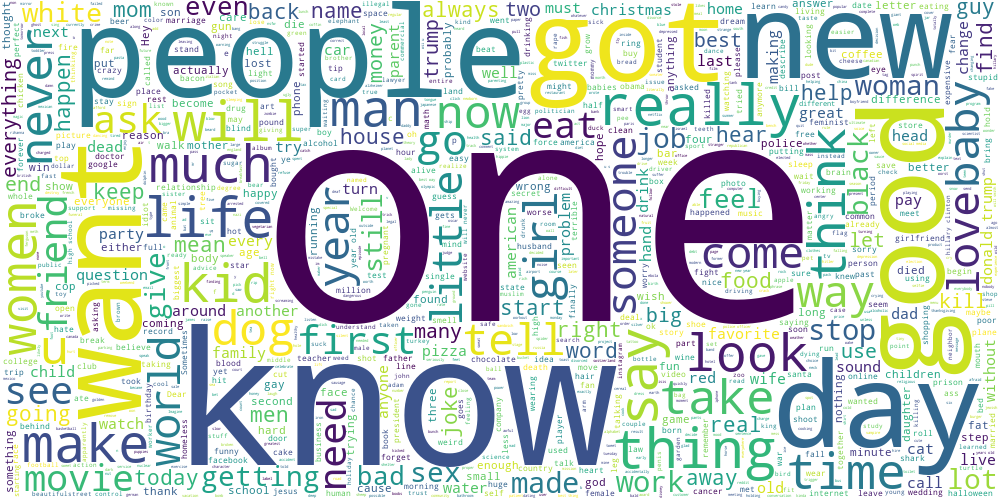

In [ ]:
draw_wordcloud(jokes_tokens[preds == 0])

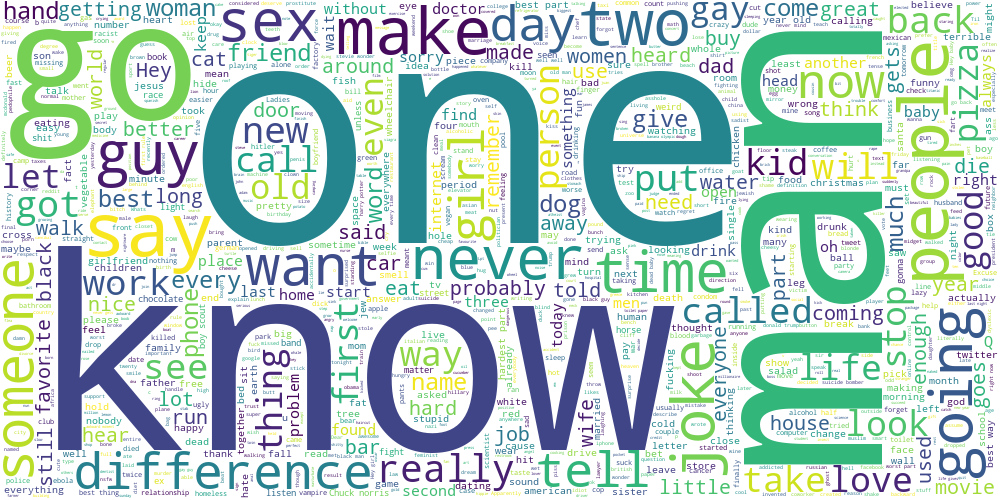

In [ ]:
draw_wordcloud(jokes_tokens[preds == 1])

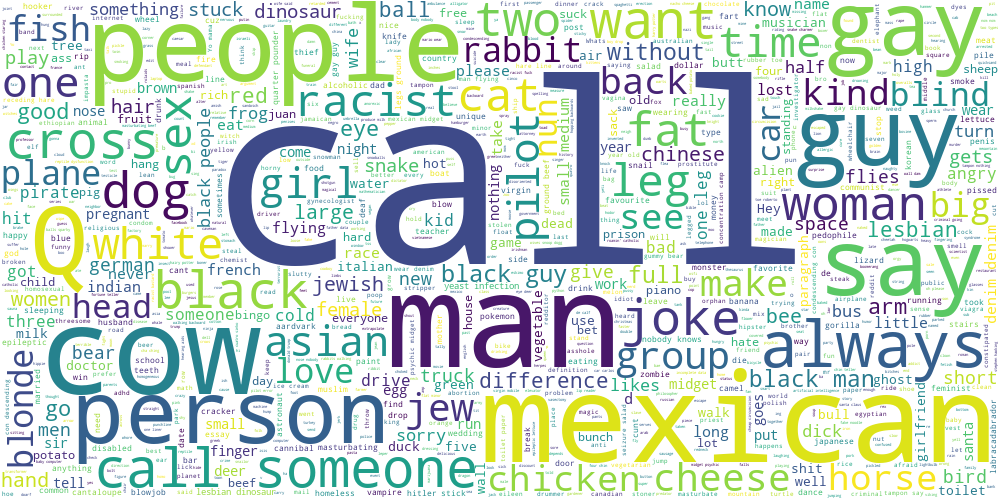

In [ ]:
draw_wordcloud(jokes_tokens[preds == 2])

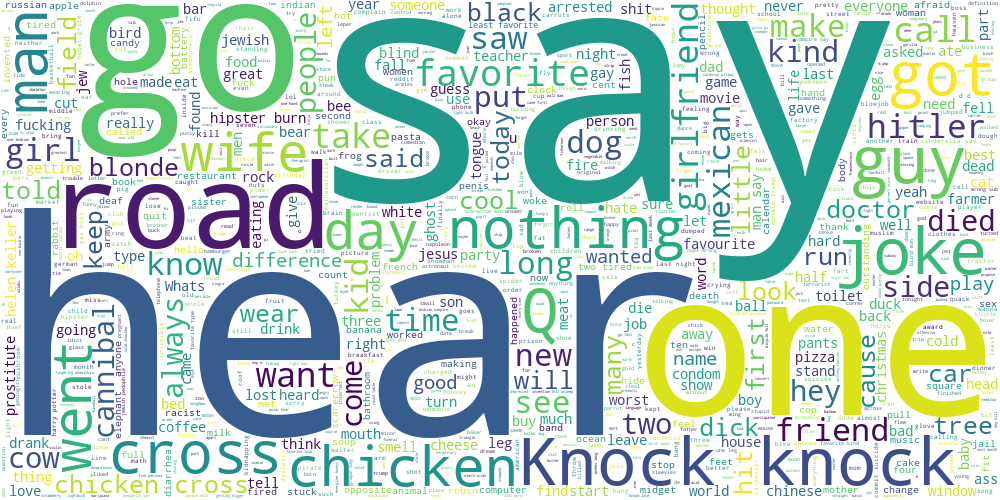

In [ ]:
draw_wordcloud(jokes_tokens[preds == 3])

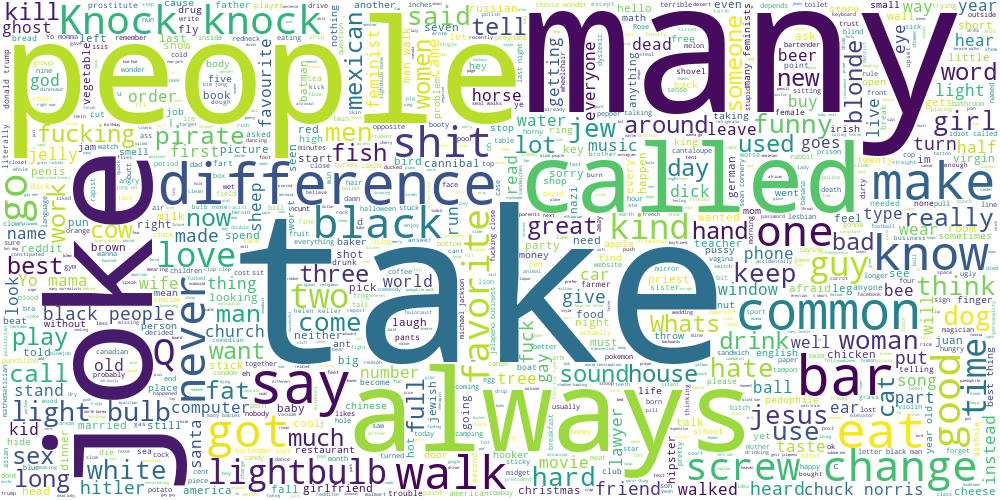

In [ ]:
draw_wordcloud(jokes_tokens[preds == 4])

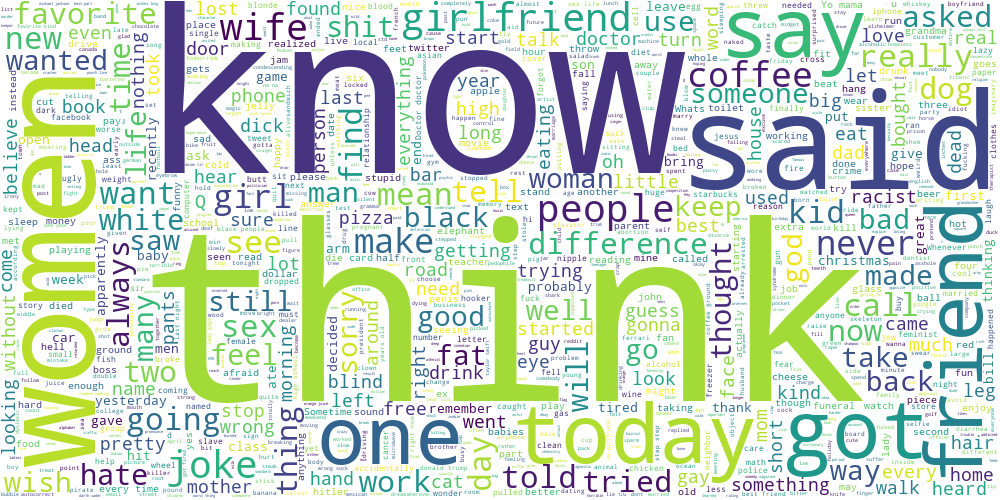

In [ ]:
draw_wordcloud(jokes_tokens[preds == 5])

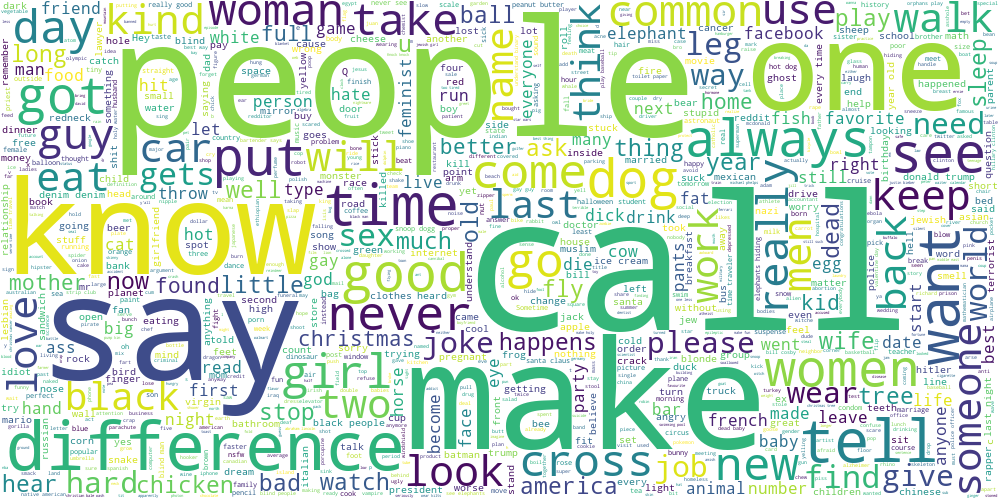

In [ ]:
draw_wordcloud(jokes_tokens[preds == 6])

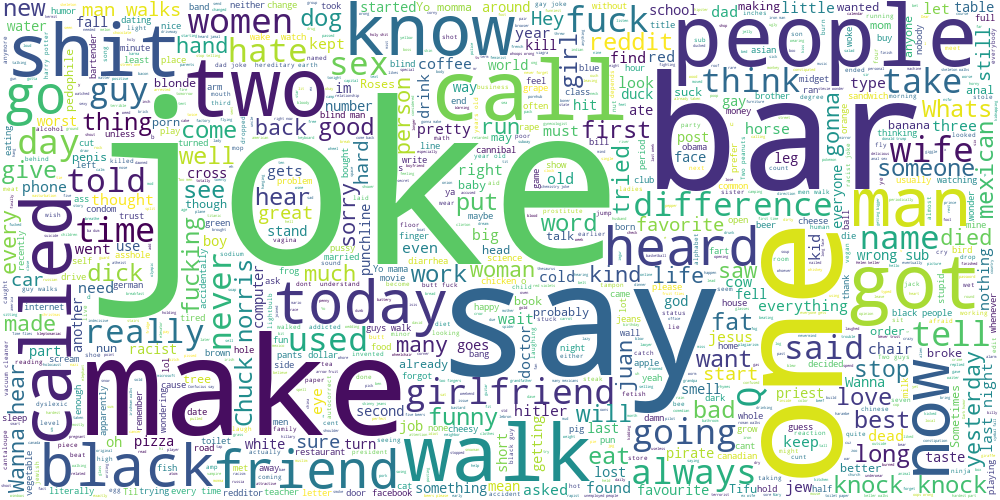

In [ ]:
draw_wordcloud(jokes_tokens[preds == 7])

получилось не особо интерпретируемо. зависимости не очевидны. давайте подберем оптимальное количество кластеров

In [ ]:
from tqdm import tqdm
inertia_dict = {}
clusters_arr = [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]
for n_clusters in tqdm(clusters_arr):
    kmeans_model = KMeans(n_clusters = n_clusters)
    kmeans_model.fit_predict(jokes_embs)
    inertia_dict[n_clusters] = kmeans_model.inertia_

100%|██████████| 14/14 [00:50<00:00,  3.61s/it]


In [ ]:
inertia_dict

{3: 5363421184.0,
 4: 5278653952.0,
 5: 5214348288.0,
 6: 5162129920.0,
 7: 5123694592.0,
 8: 5089331712.0,
 9: 5060347392.0,
 10: 5034285056.0,
 11: 5009084928.0,
 12: 4986191360.0,
 13: 4963660288.0,
 14: 4945262080.0,
 15: 4928121344.0,
 16: 4911671808.0}

Внутренняя метрика inertia для KMeans уменьшается, если уменьшать общее число кластеров

In [ ]:
kmeans_model = KMeans(n_clusters = 3)
preds = kmeans_model.fit_predict(jokes_embs)

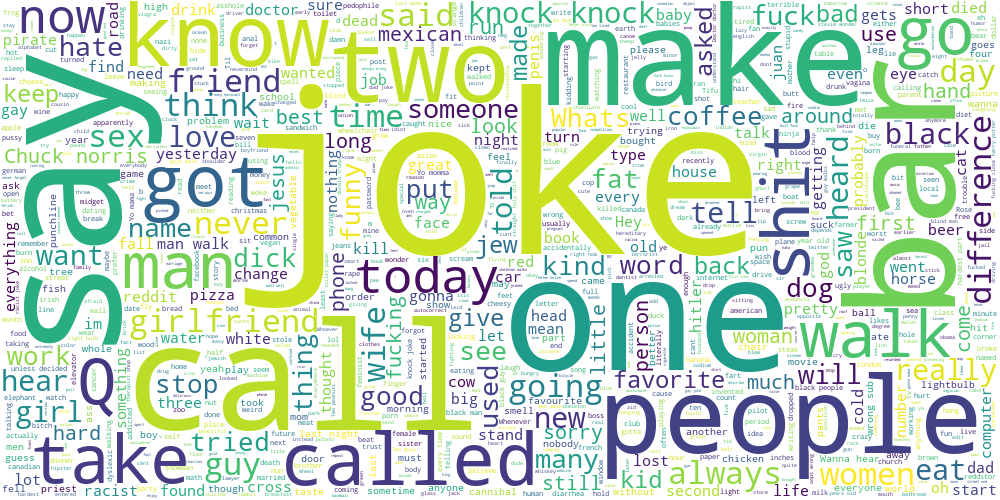

In [ ]:
draw_wordcloud(jokes_tokens[preds == 0])

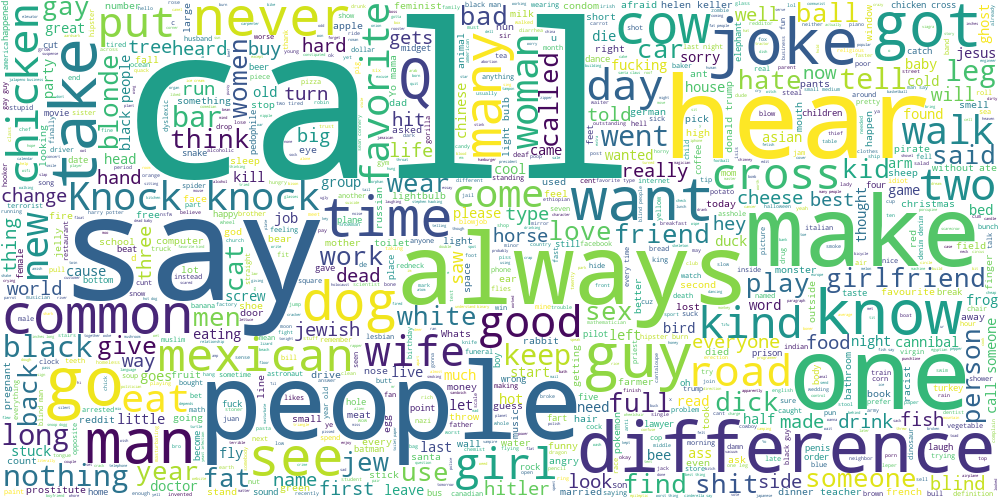

In [ ]:
draw_wordcloud(jokes_tokens[preds == 1])

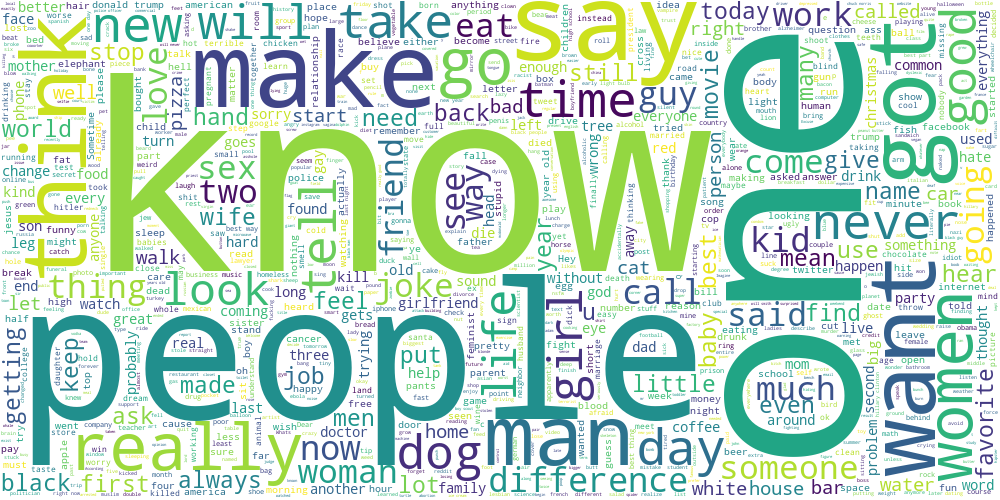

In [ ]:
draw_wordcloud(jokes_tokens[preds == 2])

Из этих облаков слов получается только узнать часто встречающиеся в шутках слова: в основном это простая лексика, то есть простые и часто используемые в речи слова. Всё еще неочевидно, по какому интерпретируемому признаку можно было бы разделить шутки на такие кластеры.

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfidfVec = TfidfVectorizer(min_df=10)
jokes_tfidf = tfidfVec.fit_transform(jokes_tokens)

In [ ]:
jokes_tfidf.shape

(30032, 3441)

Применим алгоритмы DBSCAN и KMeans с параметрами по умолчанию для кластеризации

In [ ]:
kmeans_preds = KMeans().fit_predict(jokes_tfidf)
dbscan_preds = DBSCAN().fit_predict(jokes_tfidf)

In [ ]:
len(np.unique(kmeans_preds)), len(np.unique(dbscan_preds))

(8, 111)

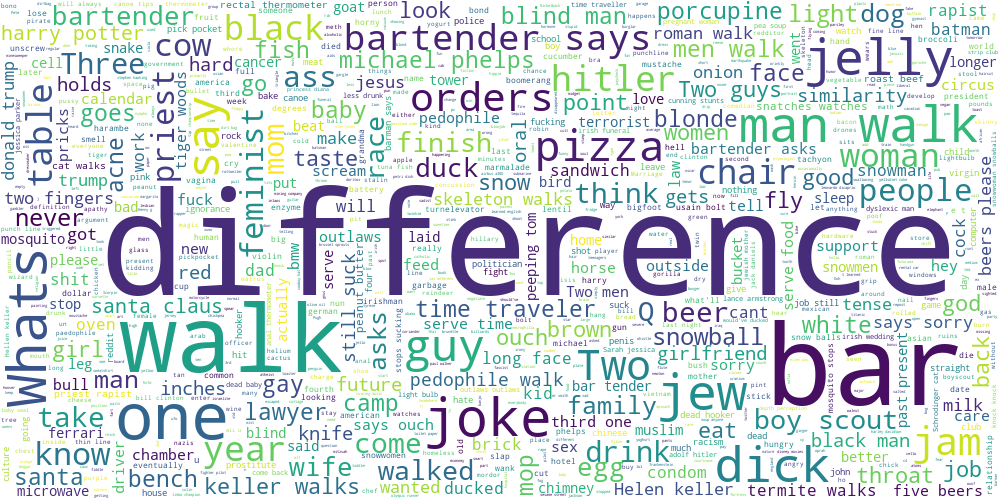

In [ ]:
draw_wordcloud(jokes_tokens[kmeans_preds == 0])

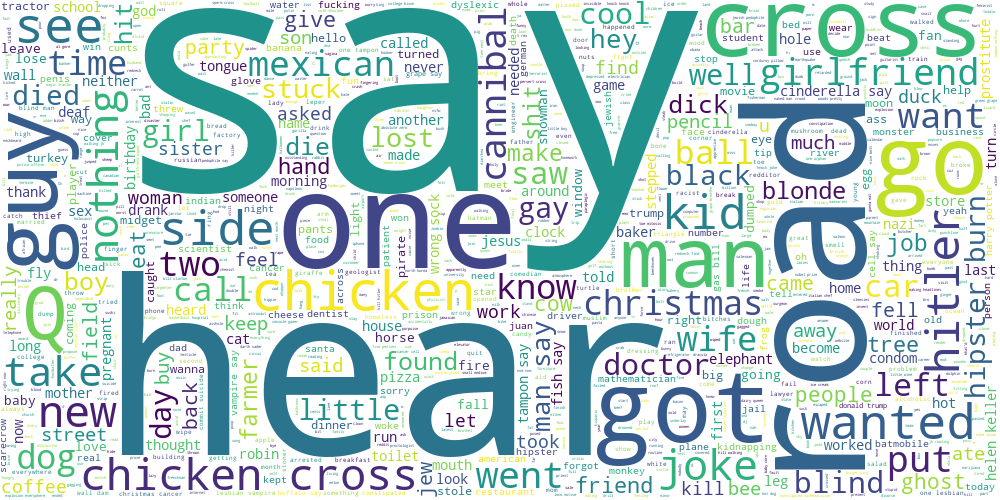

In [ ]:
draw_wordcloud(jokes_tokens[kmeans_preds == 1])

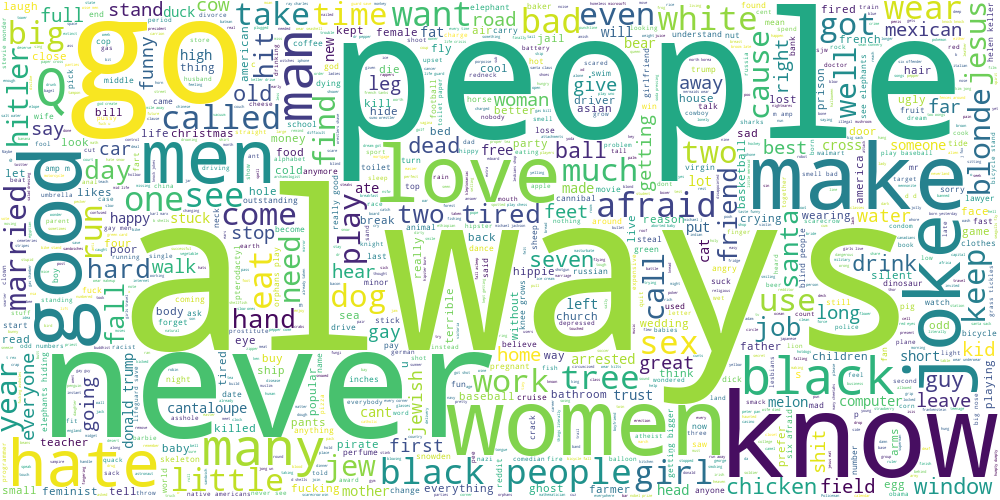

In [ ]:
draw_wordcloud(jokes_tokens[kmeans_preds == 2])

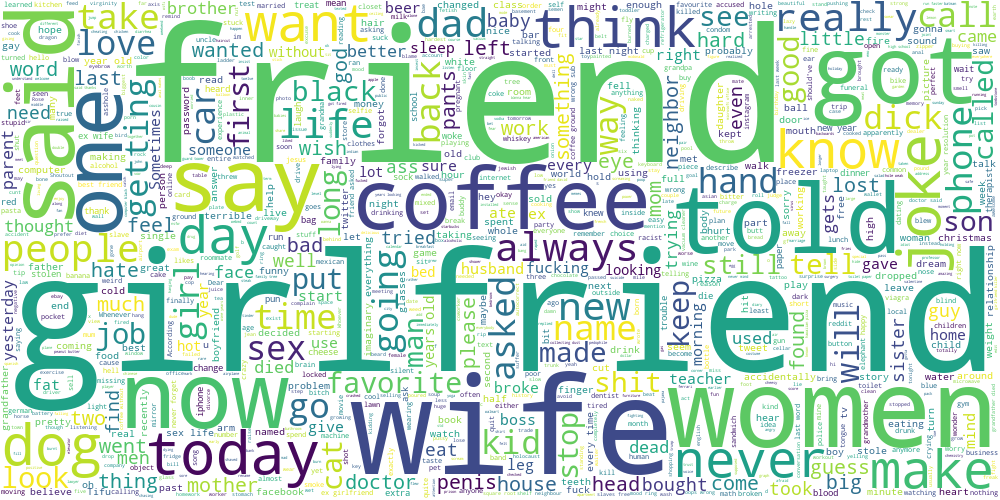

In [ ]:
draw_wordcloud(jokes_tokens[kmeans_preds == 3])

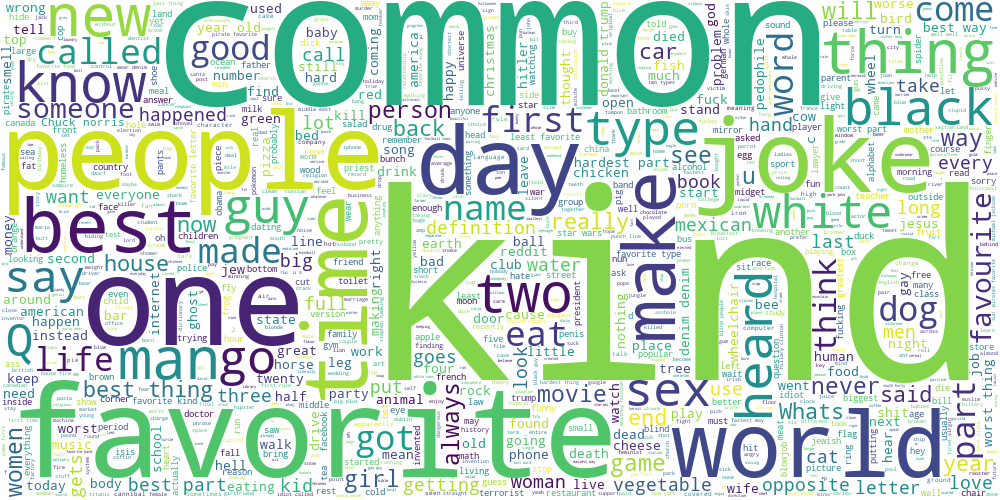

In [ ]:
draw_wordcloud(jokes_tokens[kmeans_preds == 4])

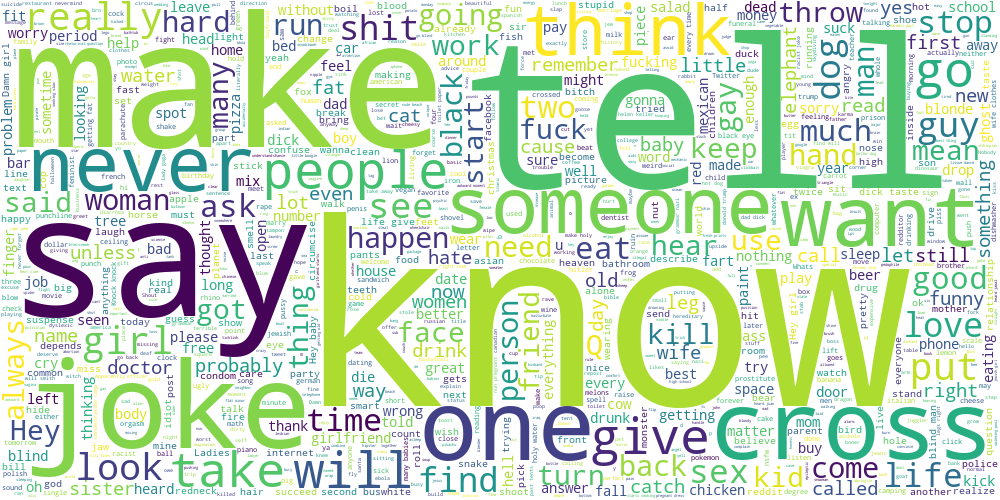

In [ ]:
draw_wordcloud(jokes_tokens[kmeans_preds == 5])

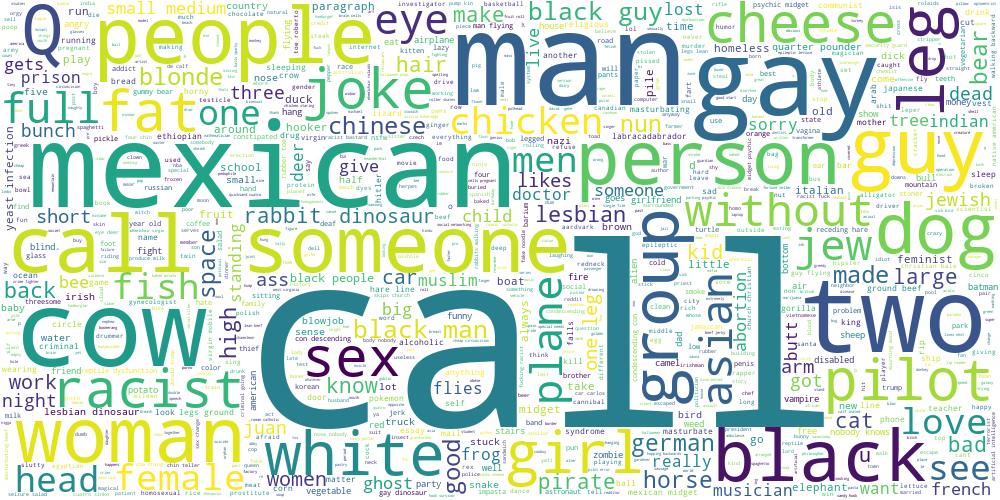

In [ ]:
draw_wordcloud(jokes_tokens[kmeans_preds == 6])

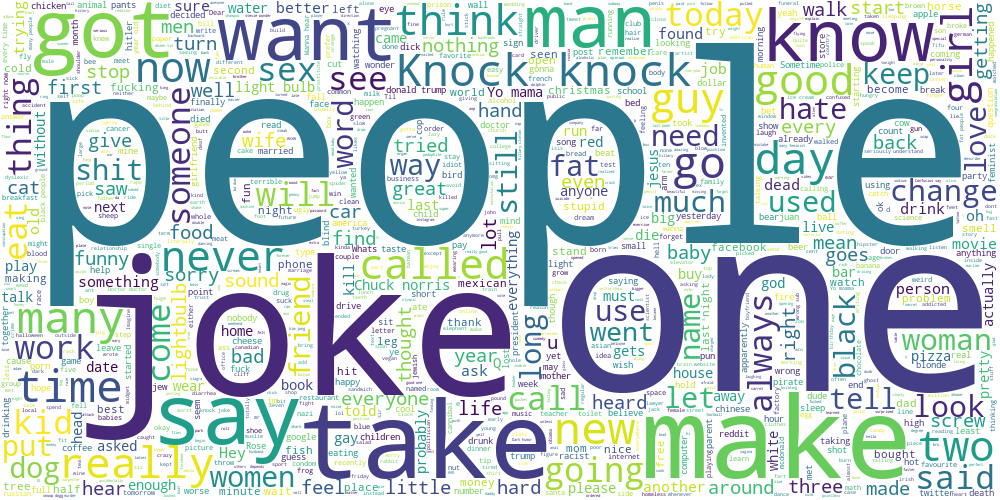

In [ ]:
draw_wordcloud(jokes_tokens[kmeans_preds == 7])

В одном из кластеров по наиболее часто встречавшимся словам
- friend
- girlfriend
- wife
и другим можно предположить, что этот кластер шуток объединяет близость к теме взаимоотношений в паре.

Также заметно, что в некоторых кластерах, например, в последнем, есть слова, встречающиеся очень часто, и таких всего несколько. Это позволяет высказать предположение, что модель посчитала нужным сгруппировать в один кластер тексты, в которых есть эти слова, не сильно учитывая остальное.

#### Визуализация кластеров в двумерном пространстве:

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, init='random')
coords = tsne.fit_transform(jokes_tfidf)

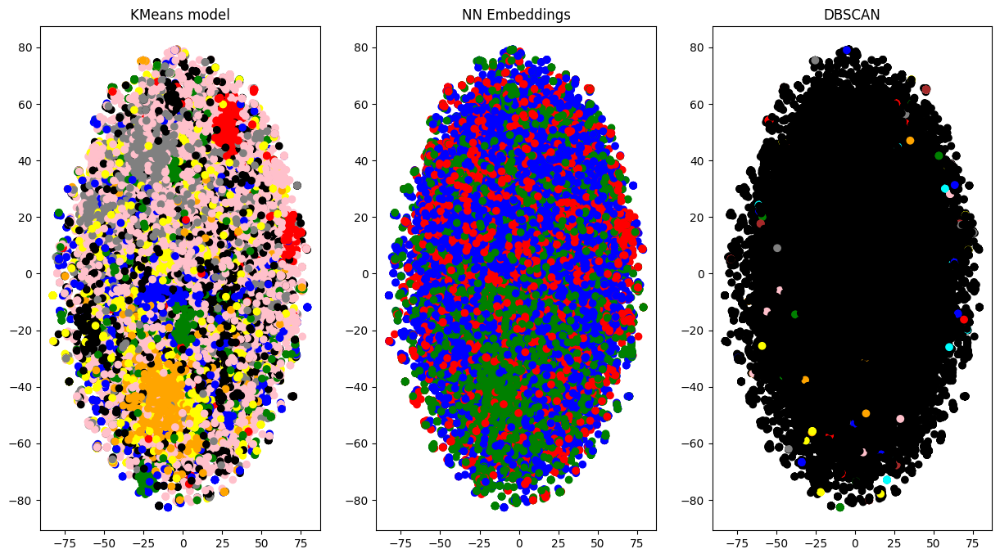

In [ ]:
colors = np.array(['red', 'green', 'blue', 'grey', 'black', 'yellow', 'orange', 'pink', 'brown', 'cyan', 'black'] * 11)
coords_x, coords_y = coords[:, 0], coords[:, 1]
plt.figure(figsize=(15, 8))
plt.subplot(1,3,1)
plt.title('KMeans model')
plt.scatter(coords_x, coords_y, c=colors[kmeans_preds])
plt.subplot(1,3,2)
plt.title('NN Embeddings')
plt.scatter(coords_x, coords_y, c=colors[preds])
plt.subplot(1,3,3)
plt.title('DBSCAN')
plt.scatter(coords_x, coords_y, c=colors[dbscan_preds])
plt.show()

Очень красиво, но, похоже, совершенно неразделимые кластеры.
Видимо, кластеризация шуток по темам, юмористическим приемам или чему-либо еще - вовсе не очевидная задача для моделей, обучающихся на эмбеддингах для простой классификации текстов на шутки / не шутки.

Также можно сказать, что и KMeans и DBSCAN не показали себя ощутимо лучше.

В задаче кластеризации шуток по tfidf и эмбеддингам, полученных вышеуказанным способом, сложно выделить более успешную модель. К сожалению, все модели справились далеко не блестяще. Несмотря на это, можно строить некоторые предположения о характере шуток в разных кластерах, глядя на облака слов, полученные в начале анализа.

**Задание 7 (0.1 балла)**. Используя литературный язык, изложите в культурной форме ваши ощущения от предыдущего ДЗ на ЕМ